# Exercice 2: Learning a WGAN for synthetic 2-dimensional datasets

<br/><br/><br/><br/>

This practical session contains
- "QUESTION" fields in the text, that you should answer
- blocks of code that you should complete at every region marked with ### ... ###

We advise you to open the notebook on Google Colab.

### Imports

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import time

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

if torch.cuda.is_available():
    device = torch.device('cuda')
    dtype = torch.cuda.FloatTensor
else:
    device = torch.device('cpu')
    dtype = torch.FloatTensor

# If you don't want to bother with the device, stay on cpu:
# device = torch.device('cpu')

print(device)

cpu


### Target Measure

In the following cell, we define the discrete target measure $\nu$ that will serve as dataset for this practical session.

The variable `xgrid` contains a grid of points that will be useful below to display the discriminators along training.

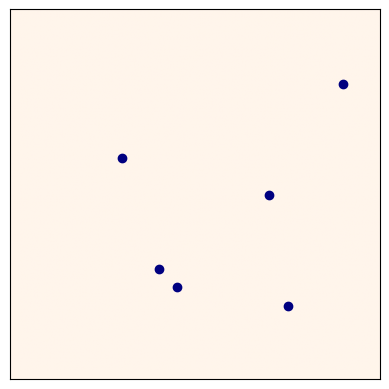

In [2]:
d = 2   # dimension of the data points

# First dataset with 6 points
n = 6
y = torch.zeros((n,d), device=device)
y[0, 0] = 0.9
y[0, 1] = 0.2
y[1, 0] = 0.75
y[1, 1] = 0.8
y[2, 0] = 0.3
y[2, 1] = 0.4
y[3, 0] = 0.4
y[3, 1] = 0.7
y[4, 0] = 0.45
y[4, 1] = 0.75
y[5, 0] = 0.7
y[5, 1] = 0.5

# # Second dataset with 100 points
# n = 100
# t = torch.pi*torch.linspace(-.2,1.2,n)
# y = .05*torch.randn((n,d))
# y[:,0] += torch.cos(t)
# y[:,1] += torch.sin(2*t)
# y = .5 + .3*y
# y = y.to(device)

# Define masses (empirical measure on the data points)
nu = torch.ones(n, device=device)/n

# generate grid for plotting purpose
nr,nc = 256,256
extent = ((-0.5/nc, 1-0.5/nc, 1-0.5/nr, -0.5/nr))
xs = torch.linspace(0, 1, steps=nr)
ys = torch.linspace(0, 1, steps=nc)
xm, ym = torch.meshgrid(xs, ys, indexing='ij')
xm = xm.T
ym = ym.T
xgrid = torch.cat((xm.reshape(nr*nc,1),ym.reshape(nr*nc,1)),1).to(device)

# Plot data points
fig = plt.figure(dpi=100)
plt.xticks([])
plt.yticks([])
plt.imshow(np.zeros((nr,nc)),cmap = 'Oranges', extent=extent) # background
plt.scatter(y[:, 0].cpu(), y[:,1].cpu(),c='navy')
plt.show()

## Define Generator architecture

QUESTION: Examine the layers and parameters of the following generative network.

Write a short description of the architecture of this network.

ANSWER : The Generator class defines a multi-layer perceptron (MLP). The architecture begins with an input layer that accepts a vector of size n_in. This input is passed through a configurable number of hidden layers (nlayers), each consisting of a fully connected linear transformation followed by an ELU activation function. The number of units in each hidden layer is defined by n_hid and the network dynamically adjusts the input size of the first layer to match the latent dimension. The final output layer maps from the hidden representation to a vector of size n_out, which is passed through a sigmoid activation.
The weight initialization is handled using Xavier uniform initialization, with all biases initialized to zero.

In [3]:
class Generator(torch.nn.Module):

    def __init__(self, n_in, n_out, n_hid=10, nlayers=3, device=torch.device("cpu")):
        super(Generator, self).__init__()

        self.n_in = n_in
        self.n_out = n_out
        self.n_hid = n_hid
        self.nlayers = nlayers
        self.hidden = nn.ModuleList()

        for n in range(nlayers):
            n_in_t = n_in if n==0 else n_hid
            self.hidden.append(nn.Sequential(
            nn.Linear(n_in_t, n_hid),
            nn.ELU(1)
        ).to(device))

        self.out = nn.Sequential(
            nn.Linear(n_hid, n_out),
            nn.Sigmoid()
        ).to(device)

        self.apply(self._init_weights)


    def forward(self, x):
        for n in range(self.nlayers):
            x = self.hidden[n](x)
        x = self.out(x)
        return x


    def _init_weights(self, module):
        if isinstance(module, nn.Linear):
            torch.nn.init.xavier_uniform_(module.weight, 1.0)
            if module.bias is not None:
                module.bias.data.zero_()


QUESTION: Plot one initial configuration of the generator (draw a batch of generated points)

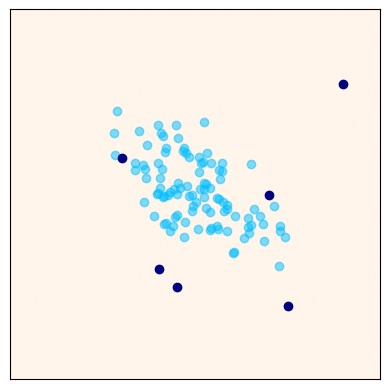

In [4]:
torch.manual_seed(0)  # initialize random seed for reproducibility

n_in = 10    # dimension of the input noise
b = 100      # batch size

# Initialize generator
G = Generator(n_in=n_in, n_out=d, n_hid=100, nlayers=3, device=device)

# Draw a batch x of generated points
#    Input noise z : standard normal with shape (b, n_in)

z = torch.randn(b, n_in, device=device)
x = G(z)
### ... ###

# Plot
xd = x.detach()
fig = plt.figure(dpi=100)
plt.xticks([])
plt.yticks([])
plt.imshow(np.zeros((nr,nc)),cmap = 'Oranges', extent=extent) # background
plt.scatter(xd[:, 0].cpu(), xd[:,1].cpu(),c='deepskyblue',alpha=.5)
plt.scatter(y[:, 0].cpu(), y[:,1].cpu(),c='navy')
plt.show()

## Define Discriminator Architecture

In [5]:
class Discriminator(nn.Module):
  def __init__(self, n_in, n_hid=10):
    super(Discriminator, self).__init__()

    self.n_hid = n_hid
    self.n_in = n_in

    self.fc1 = nn.Linear(n_in, n_hid)
    self.fc2 = nn.Linear(n_hid, n_hid)
    self.fc3 = nn.Linear(n_hid, 1)

  def forward(self, x):
    y = nn.LeakyReLU(negative_slope=0.2)(self.fc1(x))
    y = nn.LeakyReLU(negative_slope=0.2)(self.fc2(y))
    y = self.fc3(y)
    return y

## Discriminator training with Weight clipping

QUESTION: For a fixed generator, train the discriminator with WGAN loss and weight clipping.

Try changing the clip_value. What do you observe?

ANSWER : By changing the clip_value we observe that a small clip_value can lead to underfitting while a larger clip_value can lead to the discriminator learning a simpler function that is not absle to capture the complexity of the data distribution.

[0/1000], -0.007988


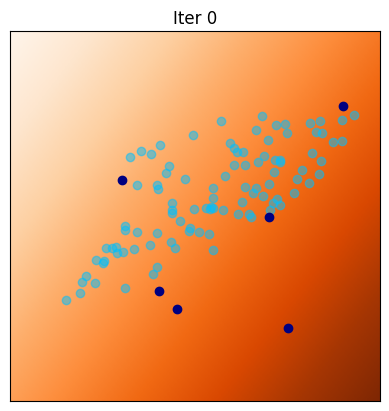

[100/1000], -0.000401


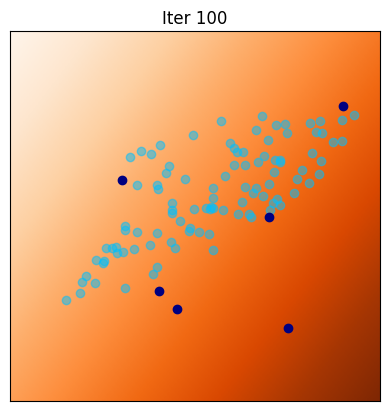

[200/1000], -0.000401


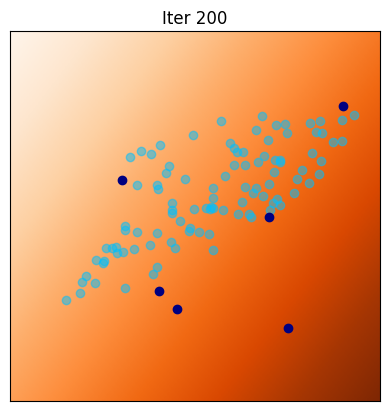

[300/1000], -0.000401


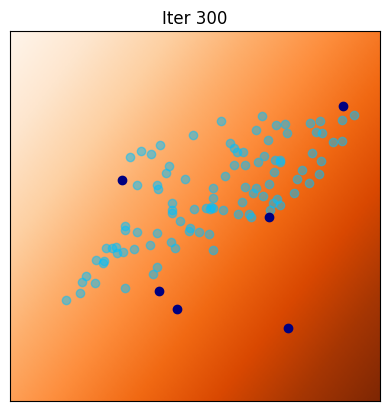

[400/1000], -0.000401


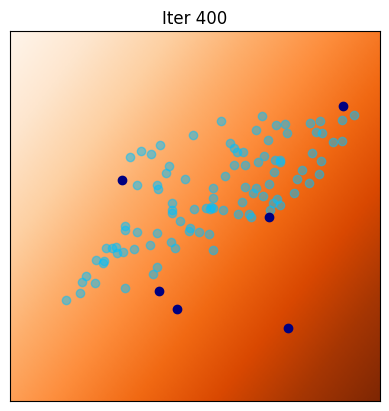

[500/1000], -0.000401


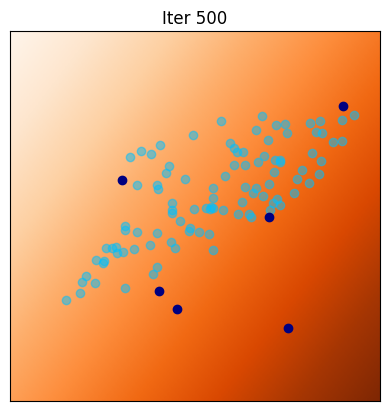

[600/1000], -0.000401


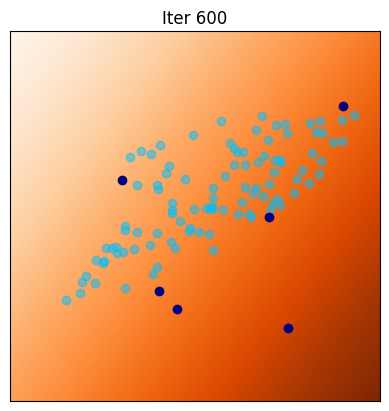

[700/1000], -0.000401


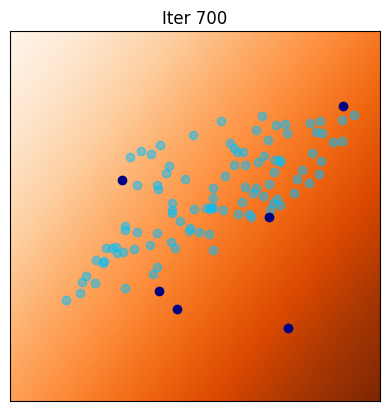

[800/1000], -0.000401


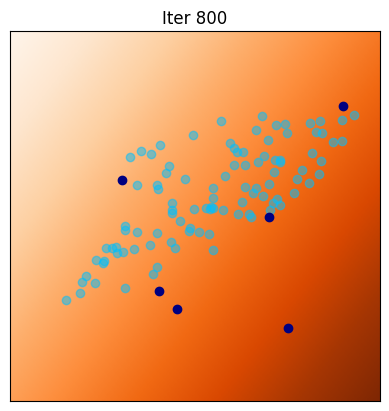

[900/1000], -0.000401


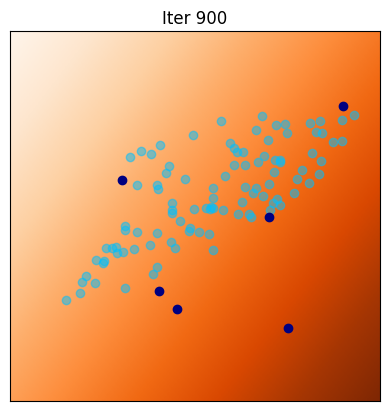

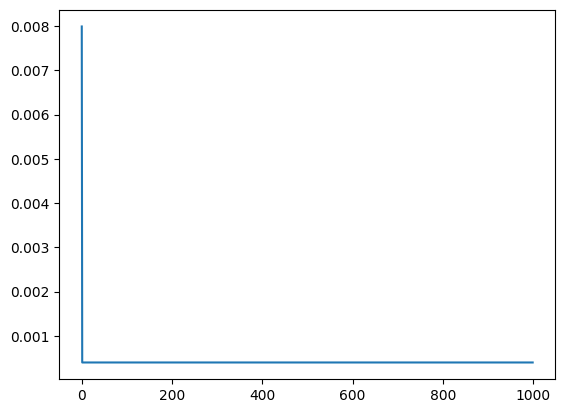

In [6]:
torch.manual_seed(1)  # initialize random seed for reproducibility

# fix one generator
G = Generator(n_in=n_in, n_out=d, n_hid=10, nlayers=3, device=device)

# parameters for discriminator optimization
lrdisc = 0.002
beta_1 = 0.5
beta_2 = 0.999
niterD=1000

clip_value = .1

D = Discriminator(n_in=d, n_hid=10).to(device)
optimD = optim.Adam(D.parameters(), lr=lrdisc, betas=(beta_1, beta_2))

iter_display = 100  # display current configuration each iter_display iteration

# Lists to keep track of progress
Dlosses = []

for iter in range(0,niterD):

    ### UPDATE OF D ###
    optimD.zero_grad()

    ### ... ###

    Dloss =  -torch.mean(D(y)) + torch.mean(D(x)) ### ... ###

    ### ... ###

    optimD.step()

    ### ... Weight Clipping ... ###
    for p in D.parameters():
        p.data.clamp_(-clip_value, clip_value)

    ### SAVE LOSS ###
    Dlosst = Dloss.item()
    Dlosses.append(-Dlosst)

    if(iter%iter_display == 0):
        print('[%d/%d], %f' % (iter, niterD, Dlosst))
        Dxgrid = D(xgrid).detach().cpu().numpy().reshape(nr,nc)
        x = G(z)
        xd = x.detach().squeeze(1)
        strtitle = 'Iter '+str(iter)
        fig = plt.figure(dpi=100)
        plt.xticks([])
        plt.yticks([])
        plt.imshow(Dxgrid,cmap = 'Oranges', extent=extent)  # discriminator
        plt.scatter(xd[:, 0].cpu(), xd[:,1].cpu(),c='deepskyblue',alpha=.5)
        plt.scatter(y[:, 0].cpu(), y[:,1].cpu(),c='navy')
        plt.title(strtitle)
        plt.show()

plt.plot(Dlosses)

## Estimate the Lipschitz constant of the discriminator

The following function computes a lower bound of the Lipschitz constant of $D$ on points that are interpolated between $x$ and $y$.

NB: If $x$ and $y$ do not have the same number of points, we discard the last points.
In comment, we give an alternative code that allows to compute all segments $[x_i, y_j]$ (but it is, of course, slower that just computing segments $[x_i, y_i]$).

In [7]:
def lipconstant(D,x,y):
    b = x.shape[0]
    n = y.shape[0]
    # shrink vectors if they are too large
    if n>b:
        y = y[0:b,:]
        n = b
    else:
        x = x[0:n,:]
        b = n
    # compute interpolated points
    alpha = torch.rand((b,1),device=device)
    interp = alpha * y + (1 - alpha) * x
    interp.requires_grad_()

    # Calculate probability of interpolated examples
    Di = D(interp).view(-1)

    # Calculate gradients of probabilities with respect to examples
    gradout = torch.ones(Di.size()).to(device)
    gradients = torch.autograd.grad(outputs=Di, inputs=interp, grad_outputs=gradout,
       create_graph=True, retain_graph=True)[0]

    # Derivatives of the gradient close to 0 can cause problems because of
    # the square root, so manually calculate norm and add epsilon
    gradients_norm = torch.sqrt(torch.sum(gradients ** 2, dim=1))

    # Return gradient penalty
    return torch.mean(gradients_norm)

#     # Calculate interpolation
#     b = x.shape[0]
#     n = y.shape[0]
#     alpha = torch.rand((b,n,1),device=device)
#     interp = (alpha * y[None,:,:] + (1 - alpha) * x[:,None,:]).flatten(end_dim=1)
#     interp.requires_grad_()


QUESTION: Use this function to examine the Lipschitz constant of the final discriminator obtained above with weight clipping.


In [8]:
### ... ###
print(lipconstant(D,x,y).item())

0.004014780279248953


## Gradient Penalty

QUESTION: Implement a function computing the gradient penalty of a discriminator $D$ on points $X$ that are randomly interpolated between $x$ and $y$:
$$ GP(D) = \mathbb{E}\left[ \Big(\|\nabla D(X)\| - 1 \Big)^2 \right] .$$
In pratice you will use
$$\|\nabla D(X)\| \approx \sqrt{\|\nabla D (X)\|_2^2 + 10^{-12} } $$
to avoid numerical instability.

In [9]:
def gradient_penalty(D,x,y):
    b = x.shape[0]
    n = y.shape[0]
    # shrink vectors if they are too large
    if n>b:
        y = y[0:b,:]
        n = b
    else:
        x = x[0:n,:]
        b = n
    # compute interpolated points
    alpha = torch.rand((b,1),device=device)
    interp = (alpha * y + (1 - alpha) * x)
    interp.requires_grad_()

#     # Calculate interpolation
#     b = x.shape[0]
#     n = y.shape[0]
#     alpha = torch.rand((b,n,1),device=device)
#     interp = (alpha * y[None,:,:] + (1 - alpha) * x[:,None,:]).flatten(end_dim=1)
#     interp.requires_grad_()

    # Calculate probability of interpolated examples
    Di = D(interp).view(-1)

    # Calculate gradients of probabilities with respect to examples
    gradout = torch.ones(Di.size()).to(device)
    gradients = torch.autograd.grad(outputs=Di, inputs=interp, grad_outputs=gradout,
       create_graph=True, retain_graph=True)[0]

    # Derivatives of the gradient close to 0 can cause problems because of
    # the square root, so manually calculate norm and add epsilon
    gradients_norm = torch.sqrt(torch.sum(gradients ** 2, dim=1)) ### ... ###

    # Return gradient penalty
    return ((gradients_norm - 1) ** 2).mean()
#     return ((gradients_norm - 1) ** 2*(gradients_norm>1)).mean()

print(gradient_penalty(D,x,y))

tensor(0.9920, grad_fn=<MeanBackward0>)


## Discriminator training with Gradient Penalty

QUESTION: Complete the following code at the blocks ###...###.

Adjust the weight of the gradient penalty (parameter `gpw`) to get a Lipschitz constant $\approx 1$.

[0/1000], Dloss=8.5438, Lip(D)=0.0817


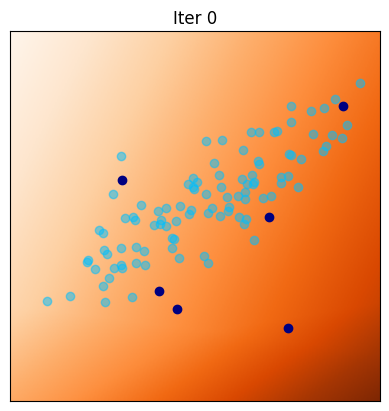

[100/1000], Dloss=0.0390, Lip(D)=0.9057


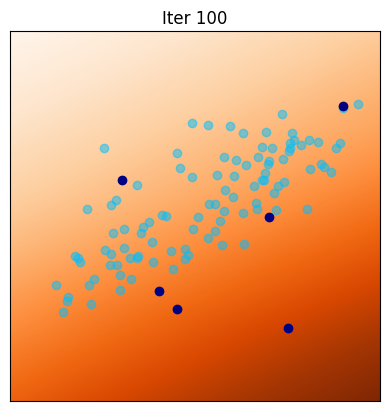

[200/1000], Dloss=-0.0503, Lip(D)=0.9789


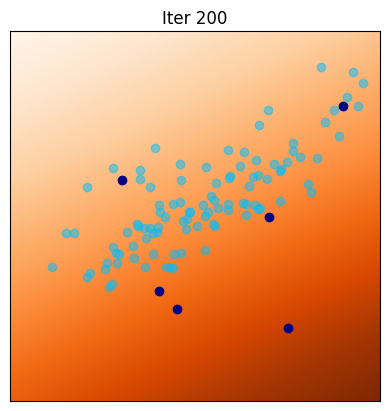

[300/1000], Dloss=-0.0927, Lip(D)=0.9957


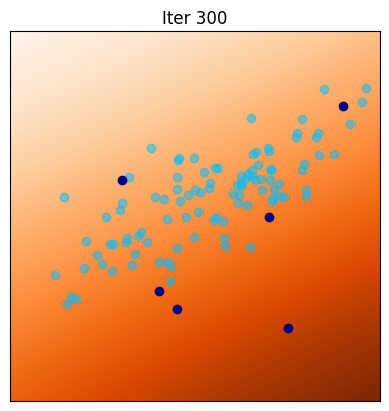

[400/1000], Dloss=-0.1036, Lip(D)=1.0112


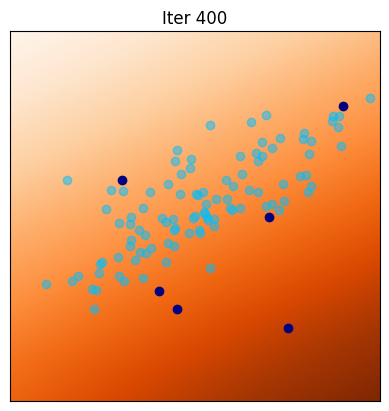

[500/1000], Dloss=-0.1255, Lip(D)=1.0116


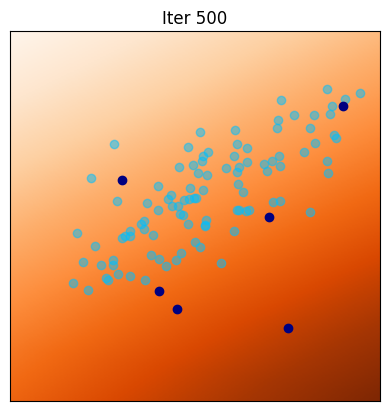

[600/1000], Dloss=-0.1253, Lip(D)=0.9983


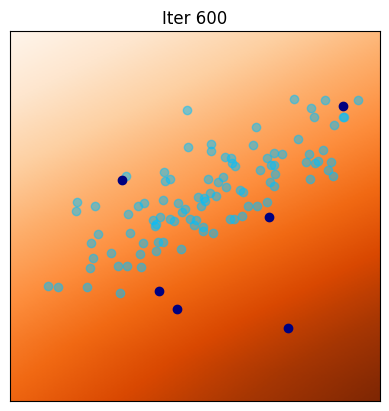

[700/1000], Dloss=-0.1137, Lip(D)=1.0056


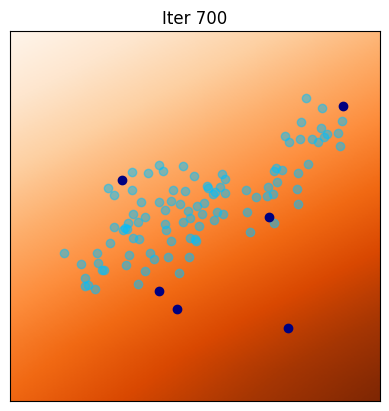

[800/1000], Dloss=-0.1102, Lip(D)=1.0157


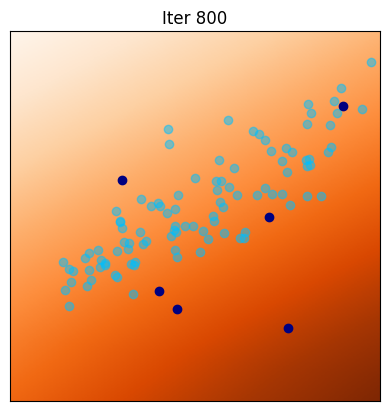

[900/1000], Dloss=-0.1133, Lip(D)=1.0104


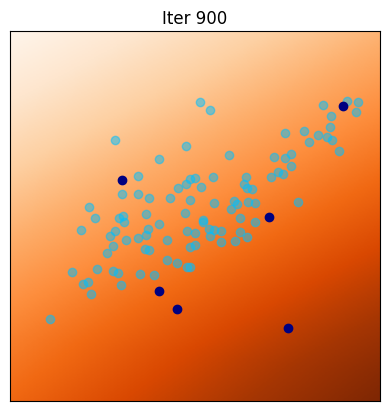

Final estimated Lipschitz constant =  1.0055556297302246


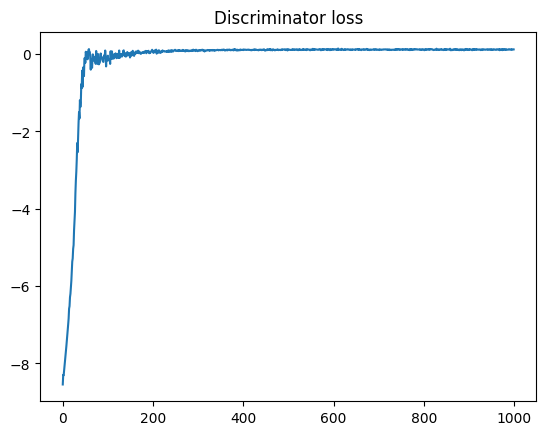

In [10]:
torch.manual_seed(1)  # initialize random seed for reproducibility

# Initialize generators and discriminators
G = Generator(n_in=n_in, n_out=d, n_hid=10, nlayers=3, device=device)
D = Discriminator(n_in=d, n_hid=10).to(device)

# parameters for training
lrdisc = 0.002
beta_1 = 0.5
beta_2 = 0.999
niterD=1000
gpw = 10       # parameter for gradient penalty

optimD = optim.Adam(D.parameters(), lr=lrdisc, betas=(beta_1, beta_2))


iter_display = 100  # display current configuration each iter_display iteration

# Lists to keep track of progress
Dlosses = []

for iter in range(0,niterD):

    ### UPDATE OF D ###

    ### ... ###

    optimD.zero_grad()
    z = torch.randn(b, n_in, device=device)
    x = G(z)
    Dloss = -torch.mean(D(y)) + torch.mean(D(x)) + gpw * gradient_penalty(D,y,x)
    Dloss.backward()

    optimD.step()

    lip = lipconstant(D,x,y)
    lip.detach()
    ### SAVE LOSS ###
    Dlosst = Dloss.item()
    Dlosses.append(-Dlosst)

    if(iter%iter_display == 0):
        print('[%d/%d], Dloss=%.4f, Lip(D)=%.4f' % (iter, niterD, Dlosst,lipconstant(D,x,y).item()))
        Dxgrid = D(xgrid).detach().cpu().numpy().reshape(nr,nc)
        x = G(z)
        xd = x.detach().squeeze(1)
        strtitle = 'Iter '+str(iter)
        fig = plt.figure(dpi=100)
        plt.xticks([])
        plt.yticks([])
        plt.imshow(Dxgrid,cmap = 'Oranges', extent=extent)  # discriminator
        plt.scatter(xd[:, 0].cpu(), xd[:,1].cpu(),c='deepskyblue',alpha=.5)
        plt.scatter(y[:, 0].cpu(), y[:,1].cpu(),c='navy')
        plt.title(strtitle)
        plt.show()

print('Final estimated Lipschitz constant = ',lipconstant(D,x,y).item())

plt.figure(dpi=100)
plt.plot(Dlosses)
plt.title('Discriminator loss')
plt.show()

## WGAN-GP training

QUESTION: Complete the following code in order to train simultaneously the generator and discriminator.

You will alternate `niterD` iterations on the discriminator and `niterG` iterations of the discriminator.

[1/100] 	Loss_D: -0.1627	Loss_G: -1.6600	Lip(D)=1.5376
[2/100] 	Loss_D: -0.1522	Loss_G: -1.1514	Lip(D)=1.5777
[3/100] 	Loss_D: -0.1083	Loss_G: -0.9149	Lip(D)=1.4853
[4/100] 	Loss_D: -0.1053	Loss_G: -2.0756	Lip(D)=0.9909
[5/100] 	Loss_D: -0.1330	Loss_G: -3.9474	Lip(D)=1.2000


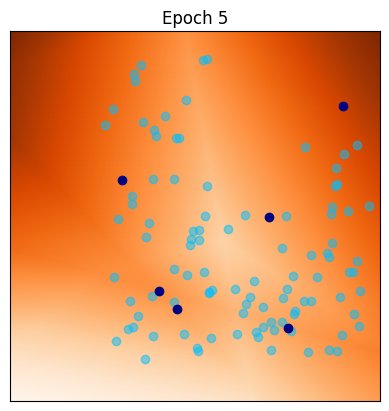

[6/100] 	Loss_D: -0.1236	Loss_G: -3.5221	Lip(D)=1.4056
[7/100] 	Loss_D: -0.1779	Loss_G: -4.5117	Lip(D)=1.7437
[8/100] 	Loss_D: -0.0918	Loss_G: -5.0585	Lip(D)=1.4596
[9/100] 	Loss_D: -0.1335	Loss_G: -5.5118	Lip(D)=1.4454
[10/100] 	Loss_D: -0.0670	Loss_G: -5.2542	Lip(D)=1.6102


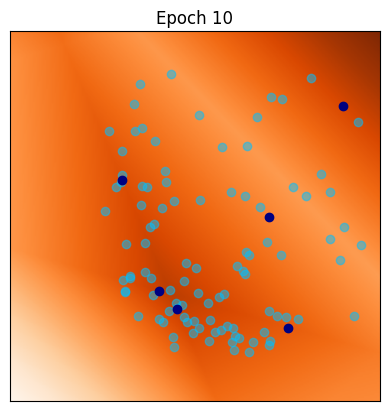

[11/100] 	Loss_D: -0.0882	Loss_G: -5.0587	Lip(D)=1.2724
[12/100] 	Loss_D: -0.0831	Loss_G: -4.5260	Lip(D)=1.4769
[13/100] 	Loss_D: -0.0638	Loss_G: -4.4032	Lip(D)=1.2435
[14/100] 	Loss_D: -0.0731	Loss_G: -6.1114	Lip(D)=1.3475
[15/100] 	Loss_D: -0.1172	Loss_G: -7.8294	Lip(D)=1.3871


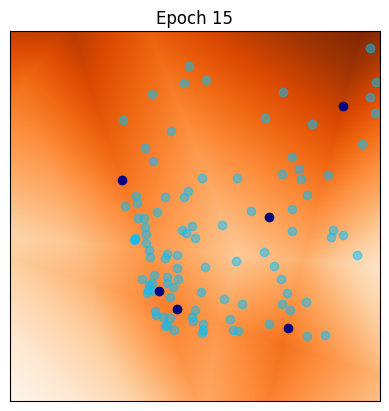

[16/100] 	Loss_D: -0.0739	Loss_G: -8.8798	Lip(D)=1.2904
[17/100] 	Loss_D: -0.0816	Loss_G: -9.1737	Lip(D)=1.3174
[18/100] 	Loss_D: -0.0992	Loss_G: -10.9910	Lip(D)=1.3549
[19/100] 	Loss_D: -0.0635	Loss_G: -11.2474	Lip(D)=1.2787
[20/100] 	Loss_D: -0.0885	Loss_G: -13.1874	Lip(D)=1.2413


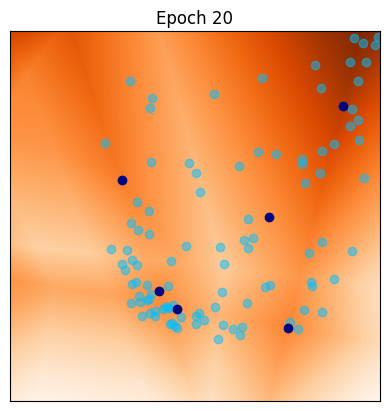

[21/100] 	Loss_D: -0.0859	Loss_G: -13.0889	Lip(D)=1.3173
[22/100] 	Loss_D: -0.0942	Loss_G: -14.5074	Lip(D)=1.2992
[23/100] 	Loss_D: -0.0753	Loss_G: -15.7387	Lip(D)=1.2779
[24/100] 	Loss_D: -0.1026	Loss_G: -13.2271	Lip(D)=1.1899
[25/100] 	Loss_D: -0.1125	Loss_G: -15.4477	Lip(D)=1.2635


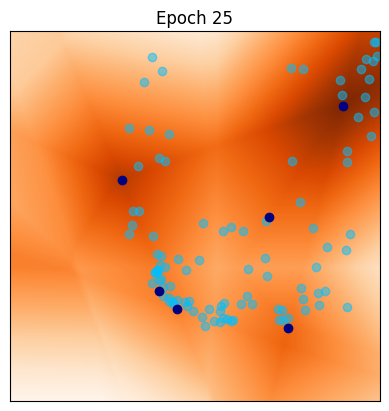

[26/100] 	Loss_D: -0.0837	Loss_G: -16.5005	Lip(D)=1.2971
[27/100] 	Loss_D: -0.0993	Loss_G: -17.7087	Lip(D)=1.3156
[28/100] 	Loss_D: -0.1048	Loss_G: -16.4698	Lip(D)=1.3644
[29/100] 	Loss_D: -0.1281	Loss_G: -12.7919	Lip(D)=1.3263
[30/100] 	Loss_D: -0.0953	Loss_G: -13.4888	Lip(D)=1.4735


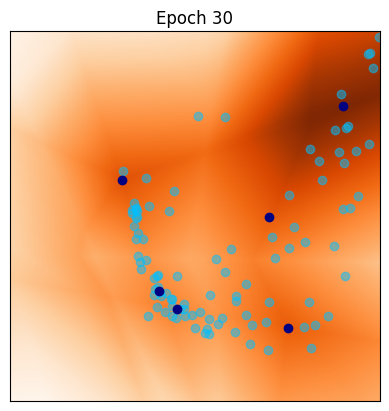

[31/100] 	Loss_D: -0.0946	Loss_G: -15.3081	Lip(D)=1.3366
[32/100] 	Loss_D: -0.0950	Loss_G: -18.8498	Lip(D)=1.3222
[33/100] 	Loss_D: -0.0884	Loss_G: -17.9027	Lip(D)=1.2893
[34/100] 	Loss_D: -0.0925	Loss_G: -14.8806	Lip(D)=1.4975
[35/100] 	Loss_D: -0.0843	Loss_G: -16.4037	Lip(D)=1.6255


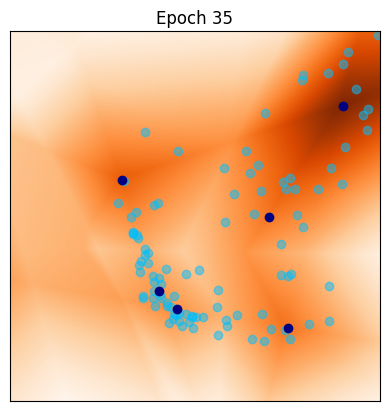

[36/100] 	Loss_D: -0.0871	Loss_G: -19.8624	Lip(D)=1.2486
[37/100] 	Loss_D: -0.0727	Loss_G: -20.9131	Lip(D)=1.2203
[38/100] 	Loss_D: -0.0659	Loss_G: -19.8203	Lip(D)=1.5782
[39/100] 	Loss_D: -0.0750	Loss_G: -17.6059	Lip(D)=1.3568
[40/100] 	Loss_D: -0.0898	Loss_G: -18.5122	Lip(D)=1.3317


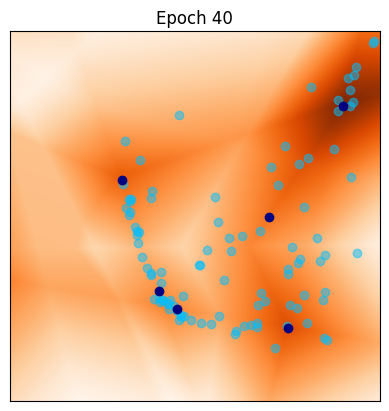

[41/100] 	Loss_D: -0.0706	Loss_G: -21.0728	Lip(D)=1.2188
[42/100] 	Loss_D: -0.0627	Loss_G: -22.6486	Lip(D)=1.5371
[43/100] 	Loss_D: -0.0880	Loss_G: -18.7145	Lip(D)=1.3875
[44/100] 	Loss_D: -0.0889	Loss_G: -18.4163	Lip(D)=1.2378
[45/100] 	Loss_D: -0.0693	Loss_G: -19.3032	Lip(D)=1.2165


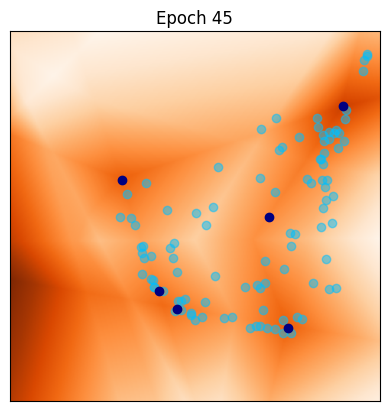

[46/100] 	Loss_D: -0.0652	Loss_G: -20.7005	Lip(D)=1.2686
[47/100] 	Loss_D: -0.0686	Loss_G: -18.2555	Lip(D)=1.2588
[48/100] 	Loss_D: -0.0907	Loss_G: -15.2649	Lip(D)=1.5336
[49/100] 	Loss_D: -0.0841	Loss_G: -15.5322	Lip(D)=1.1833
[50/100] 	Loss_D: -0.0700	Loss_G: -18.8783	Lip(D)=1.4036


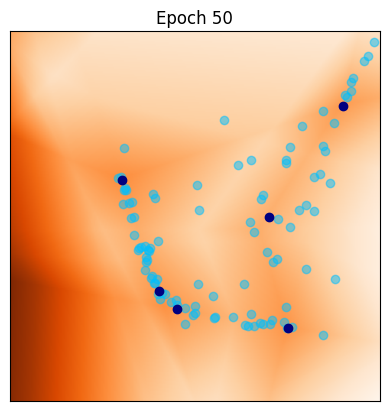

[51/100] 	Loss_D: -0.0724	Loss_G: -16.4511	Lip(D)=1.2819
[52/100] 	Loss_D: -0.0817	Loss_G: -11.9062	Lip(D)=1.3358
[53/100] 	Loss_D: -0.0785	Loss_G: -14.4013	Lip(D)=1.3947
[54/100] 	Loss_D: -0.0679	Loss_G: -15.0204	Lip(D)=1.1796
[55/100] 	Loss_D: -0.0607	Loss_G: -12.6845	Lip(D)=1.2533


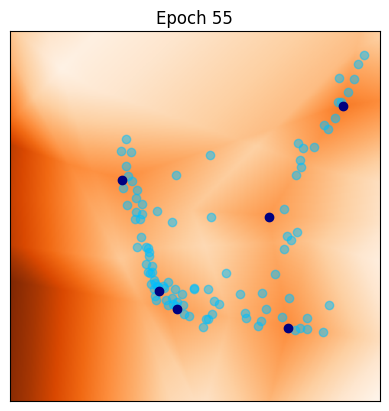

[56/100] 	Loss_D: -0.0810	Loss_G: -11.7233	Lip(D)=1.2349
[57/100] 	Loss_D: -0.0439	Loss_G: -11.7426	Lip(D)=1.2500
[58/100] 	Loss_D: -0.0840	Loss_G: -12.4730	Lip(D)=1.2349
[59/100] 	Loss_D: -0.0568	Loss_G: -14.1947	Lip(D)=1.2689
[60/100] 	Loss_D: -0.0859	Loss_G: -16.5720	Lip(D)=1.3286


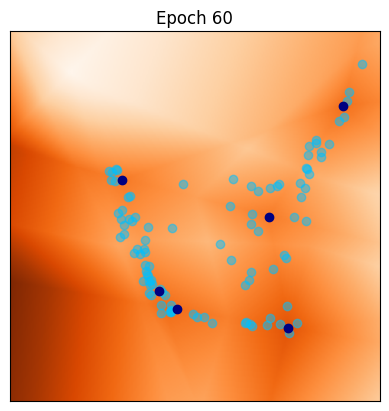

[61/100] 	Loss_D: -0.0459	Loss_G: -19.9190	Lip(D)=1.2269
[62/100] 	Loss_D: -0.0751	Loss_G: -17.0633	Lip(D)=1.2067
[63/100] 	Loss_D: -0.0768	Loss_G: -15.8825	Lip(D)=1.4322
[64/100] 	Loss_D: -0.0792	Loss_G: -18.2309	Lip(D)=1.2603
[65/100] 	Loss_D: -0.0724	Loss_G: -20.3954	Lip(D)=1.4490


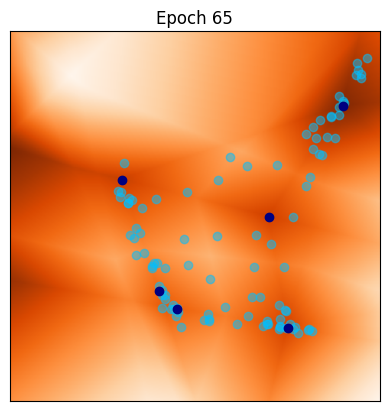

[66/100] 	Loss_D: -0.0631	Loss_G: -20.0423	Lip(D)=1.3662
[67/100] 	Loss_D: -0.0821	Loss_G: -18.3857	Lip(D)=1.3379
[68/100] 	Loss_D: -0.0542	Loss_G: -19.8013	Lip(D)=1.1448
[69/100] 	Loss_D: -0.0907	Loss_G: -22.2605	Lip(D)=1.2211
[70/100] 	Loss_D: -0.0740	Loss_G: -20.9620	Lip(D)=1.2301


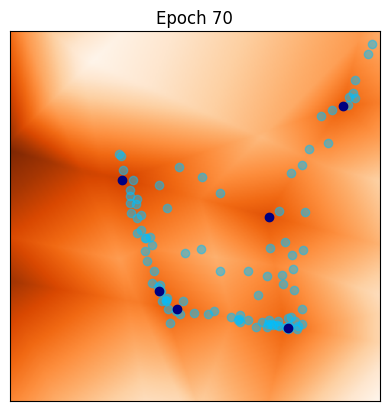

[71/100] 	Loss_D: -0.0634	Loss_G: -18.8522	Lip(D)=1.3973
[72/100] 	Loss_D: -0.0406	Loss_G: -19.9462	Lip(D)=1.4164
[73/100] 	Loss_D: -0.0668	Loss_G: -23.1518	Lip(D)=1.1641
[74/100] 	Loss_D: -0.0482	Loss_G: -22.0278	Lip(D)=1.1975
[75/100] 	Loss_D: -0.0616	Loss_G: -21.2801	Lip(D)=1.1866


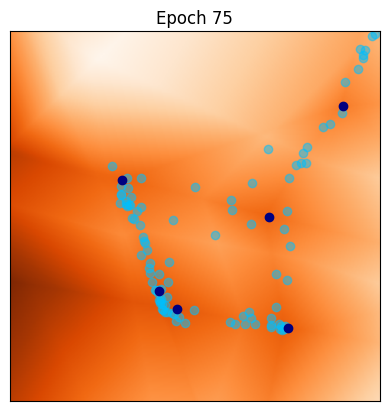

[76/100] 	Loss_D: -0.0792	Loss_G: -20.6419	Lip(D)=1.2193
[77/100] 	Loss_D: -0.0249	Loss_G: -22.7023	Lip(D)=1.3519
[78/100] 	Loss_D: -0.0548	Loss_G: -22.7304	Lip(D)=1.0908
[79/100] 	Loss_D: -0.0741	Loss_G: -19.8747	Lip(D)=1.2252
[80/100] 	Loss_D: -0.0549	Loss_G: -21.0286	Lip(D)=1.0989


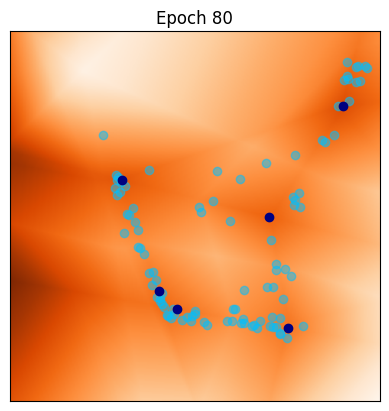

[81/100] 	Loss_D: -0.0528	Loss_G: -25.2701	Lip(D)=1.2395
[82/100] 	Loss_D: -0.0634	Loss_G: -25.2538	Lip(D)=1.1414
[83/100] 	Loss_D: -0.0702	Loss_G: -22.6838	Lip(D)=1.3067
[84/100] 	Loss_D: -0.0667	Loss_G: -27.5138	Lip(D)=1.1704
[85/100] 	Loss_D: -0.0531	Loss_G: -29.6115	Lip(D)=1.3971


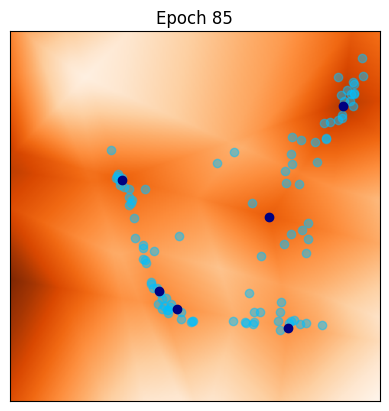

[86/100] 	Loss_D: -0.0700	Loss_G: -29.9496	Lip(D)=1.2327
[87/100] 	Loss_D: -0.0560	Loss_G: -31.7379	Lip(D)=1.2864
[88/100] 	Loss_D: -0.0562	Loss_G: -35.9028	Lip(D)=1.2385
[89/100] 	Loss_D: -0.0578	Loss_G: -40.2785	Lip(D)=1.1860
[90/100] 	Loss_D: -0.0727	Loss_G: -36.9596	Lip(D)=1.1875


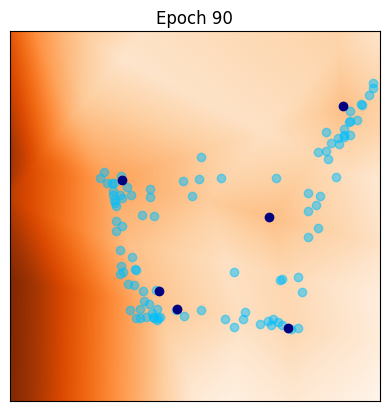

[91/100] 	Loss_D: -0.0700	Loss_G: -40.5844	Lip(D)=1.2366
[92/100] 	Loss_D: -0.1001	Loss_G: -45.5185	Lip(D)=1.1927
[93/100] 	Loss_D: -0.1003	Loss_G: -38.7052	Lip(D)=1.3896
[94/100] 	Loss_D: -0.1385	Loss_G: -39.2413	Lip(D)=1.3927
[95/100] 	Loss_D: -0.1123	Loss_G: -44.8420	Lip(D)=1.5230


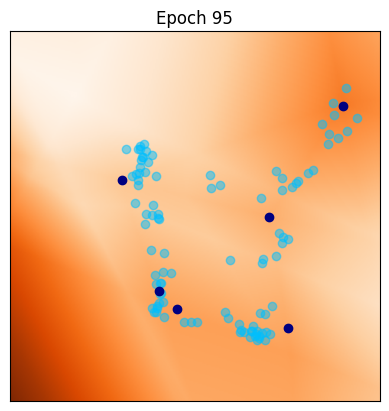

[96/100] 	Loss_D: -0.0984	Loss_G: -45.3130	Lip(D)=1.1559
[97/100] 	Loss_D: -0.1355	Loss_G: -45.0708	Lip(D)=1.2533
[98/100] 	Loss_D: -0.1022	Loss_G: -46.2088	Lip(D)=1.1193
[99/100] 	Loss_D: -0.1206	Loss_G: -48.4151	Lip(D)=1.4116


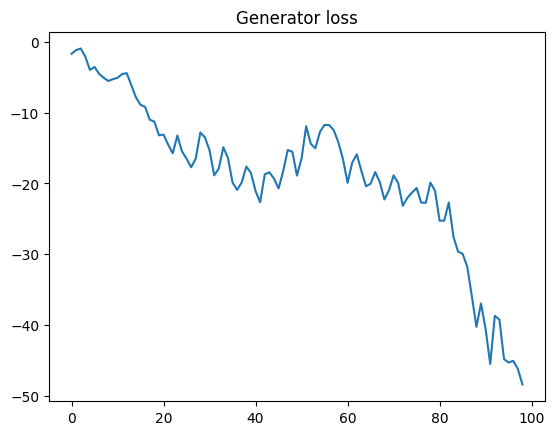

<All keys matched successfully>

In [11]:
## parameters for training
n_epochs = 100
niterD=1000
niterG=10
gpw = .1

lr = 0.002      # learning rate for generator
lrdisc = 0.002  # learning rate for discriminator
beta_1 = 0.5
beta_2 = 0.999

torch.manual_seed(1)  # initialize random seed for reproducibility

# Initialize generators and discriminators
G = Generator(n_in=n_in, n_out=d, n_hid=10, nlayers=3, device=device)
optimG = optim.Adam(G.parameters(), lr=lr)

D = Discriminator(n_in=d, n_hid=10).to(device)
optimD = optim.Adam(D.parameters(), lr=lrdisc, betas=(beta_1, beta_2))


Glosses = []
Dlosses = []

iter_display = 5

# Main loop
for epoch in range(1,n_epochs):

    ############################
    ### Train discriminator (niterD iterations)
    ############################

    for iter in range(0,niterD):
        ### ... ###
        optimD.zero_grad()
        z = torch.randn(b, n_in, device=device)
        x = G(z)
        Dloss = -torch.mean(D(y)) + torch.mean(D(x)) + gpw * gradient_penalty(D,y,x)
        Dloss.backward()

        optimD.step()

        lip = lipconstant(D,x,y)
        lip.detach()
        Dlosst = Dloss.item()
        Dlosses.append(-Dlosst)

    ############################
    ### Train generator (niterG iterations)
    ############################
    for iter in range(0,niterG):
        ### ... ###
        G.zero_grad()
        z = torch.randn(b, n_in, device=device)
        x = G(z)
        Gloss = -torch.mean(D(x))
        Gloss.backward()
        optimG.step()
        lip = lipconstant(D,y,x)
        lip.detach()

    # Output training stats
    print('[%d/%d] \tLoss_D: %.4f\tLoss_G: %.4f\tLip(D)=%.4f'
      % (epoch, n_epochs, Dloss.item(), Gloss.item(),lipconstant(D,x,y).item()))
    Glosses.append(Gloss.item())
    Dlosses.append(Dloss.item())

    if(epoch % iter_display == 0):
        Dxgrid = D(xgrid).detach().cpu().numpy().reshape(nr,nc)
        z = torch.randn(b, n_in, device=device)
        x = G(z)
        xd = x.detach().squeeze(1)
        strtitle = 'Epoch '+str(epoch)
        fig = plt.figure(dpi=100)
        plt.xticks([])
        plt.yticks([])
        plt.imshow(Dxgrid,cmap = 'Oranges', extent=extent)
        plt.scatter(xd[:, 0].cpu(), xd[:,1].cpu(),c='deepskyblue',alpha=.5)
        plt.scatter(y[:, 0].cpu(), y[:,1].cpu(),c='navy')
        plt.title(strtitle)
        plt.show()


plt.figure(dpi=100)
plt.plot(Glosses)
plt.title('Generator loss')
plt.show()

# Save final generator for later use
wgan = Generator(n_in=n_in, n_out=d, n_hid=10, nlayers=3, device=device)
wgan.load_state_dict(G.state_dict())

## Sensitivy to hyper-parameters

QUESTION: Repeat the WGAN learning experiment, by changing the parameters of the optimization (learning rates, number of updates of D and G, etc).

From your experiments, can you draw a few recommendations for stable training?

ANSWER : In order to have a stable training we must :

* choose the gradient penalty weight and the learning rates carefully by making several tests, not too large and not too small

* Update the discriminator more often than the generator (for instance 100 updates for the discrimnator and 1 for the generator)

* Regularly monitor the estimated Lipschitz constant of the discriminator using the lipconstant function. If it deviates too much from 1, we should adjust the gradient penalty weight or learning rates.



[1/100] 	Loss_D: -0.1272	Loss_G: -1.5211	Lip(D)=1.0918
[2/100] 	Loss_D: -0.1079	Loss_G: -2.0377	Lip(D)=1.1239
[3/100] 	Loss_D: -0.1149	Loss_G: -2.3206	Lip(D)=1.1028
[4/100] 	Loss_D: -0.0867	Loss_G: -3.1807	Lip(D)=1.0781
[5/100] 	Loss_D: -0.1430	Loss_G: -5.7790	Lip(D)=1.1115


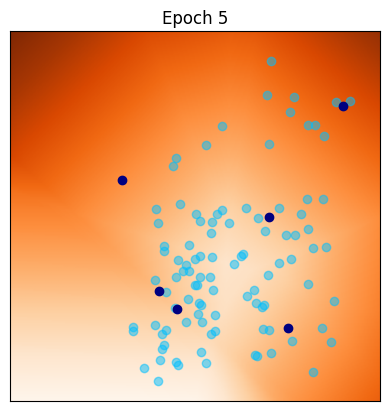

[6/100] 	Loss_D: -0.1128	Loss_G: -6.9146	Lip(D)=1.0196
[7/100] 	Loss_D: -0.0718	Loss_G: -9.5085	Lip(D)=1.0017
[8/100] 	Loss_D: -0.1029	Loss_G: -11.9071	Lip(D)=1.0610
[9/100] 	Loss_D: -0.1239	Loss_G: -11.7712	Lip(D)=1.1653
[10/100] 	Loss_D: -0.1089	Loss_G: -13.1932	Lip(D)=1.0947


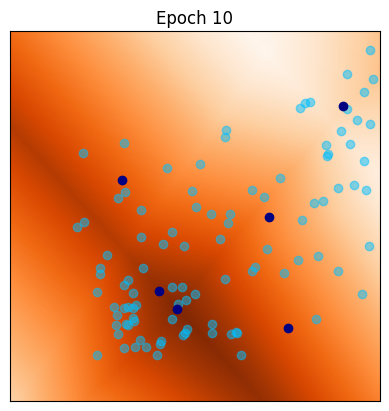

[11/100] 	Loss_D: -0.0823	Loss_G: -15.9216	Lip(D)=1.1150
[12/100] 	Loss_D: -0.0774	Loss_G: -17.1470	Lip(D)=1.0354
[13/100] 	Loss_D: -0.0512	Loss_G: -19.2407	Lip(D)=1.0002
[14/100] 	Loss_D: -0.0987	Loss_G: -17.9014	Lip(D)=1.1531
[15/100] 	Loss_D: -0.0695	Loss_G: -24.4618	Lip(D)=1.0014


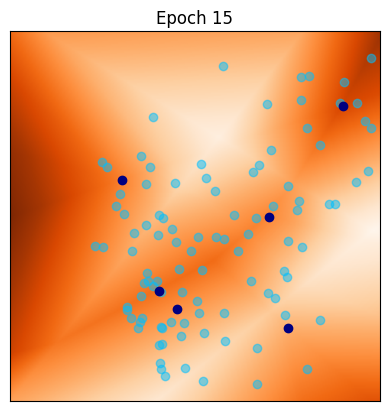

[16/100] 	Loss_D: -0.0660	Loss_G: -25.4381	Lip(D)=1.0907
[17/100] 	Loss_D: -0.0814	Loss_G: -26.8885	Lip(D)=1.0513
[18/100] 	Loss_D: -0.0670	Loss_G: -28.6492	Lip(D)=1.1792
[19/100] 	Loss_D: -0.0780	Loss_G: -28.0508	Lip(D)=1.1122
[20/100] 	Loss_D: -0.0702	Loss_G: -29.8936	Lip(D)=1.1786


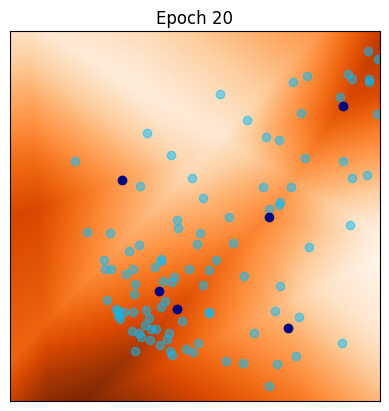

[21/100] 	Loss_D: -0.0818	Loss_G: -33.7418	Lip(D)=1.1212
[22/100] 	Loss_D: -0.0955	Loss_G: -35.6953	Lip(D)=1.1472
[23/100] 	Loss_D: -0.0675	Loss_G: -36.6502	Lip(D)=1.1050
[24/100] 	Loss_D: -0.0687	Loss_G: -35.6748	Lip(D)=1.0708
[25/100] 	Loss_D: -0.1165	Loss_G: -39.9240	Lip(D)=1.1081


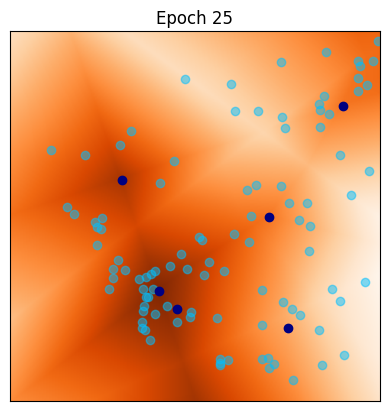

[26/100] 	Loss_D: -0.0527	Loss_G: -41.0329	Lip(D)=1.1340
[27/100] 	Loss_D: -0.1063	Loss_G: -43.3081	Lip(D)=1.1270
[28/100] 	Loss_D: -0.0764	Loss_G: -46.0398	Lip(D)=1.1331
[29/100] 	Loss_D: -0.0715	Loss_G: -40.6634	Lip(D)=1.1148
[30/100] 	Loss_D: -0.0831	Loss_G: -41.8158	Lip(D)=1.0729


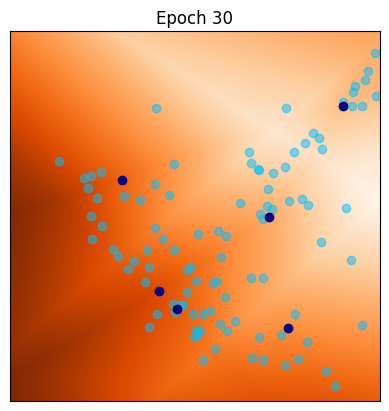

[31/100] 	Loss_D: -0.0565	Loss_G: -42.5913	Lip(D)=1.0635
[32/100] 	Loss_D: -0.0670	Loss_G: -43.7829	Lip(D)=0.9262
[33/100] 	Loss_D: -0.0895	Loss_G: -43.1551	Lip(D)=1.0006
[34/100] 	Loss_D: -0.0281	Loss_G: -41.9678	Lip(D)=1.0870
[35/100] 	Loss_D: -0.0655	Loss_G: -40.4878	Lip(D)=1.1040


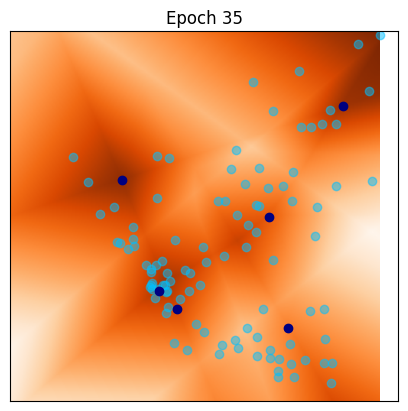

[36/100] 	Loss_D: -0.0741	Loss_G: -40.3738	Lip(D)=1.0354
[37/100] 	Loss_D: -0.0468	Loss_G: -40.4352	Lip(D)=1.0967
[38/100] 	Loss_D: -0.0565	Loss_G: -40.1780	Lip(D)=1.0373
[39/100] 	Loss_D: -0.0586	Loss_G: -38.9392	Lip(D)=1.0401
[40/100] 	Loss_D: -0.0643	Loss_G: -37.8226	Lip(D)=1.0358


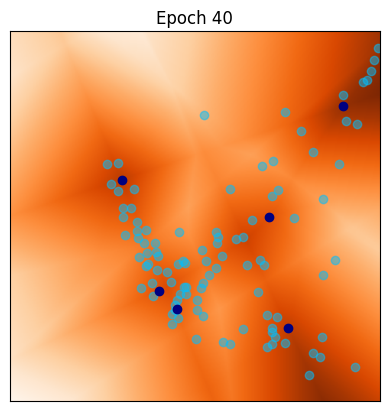

[41/100] 	Loss_D: -0.0789	Loss_G: -39.1510	Lip(D)=1.0246
[42/100] 	Loss_D: -0.0724	Loss_G: -39.6008	Lip(D)=1.1733
[43/100] 	Loss_D: -0.0683	Loss_G: -41.9413	Lip(D)=1.1111
[44/100] 	Loss_D: -0.0766	Loss_G: -43.8714	Lip(D)=0.9874
[45/100] 	Loss_D: -0.0837	Loss_G: -44.9945	Lip(D)=1.0416


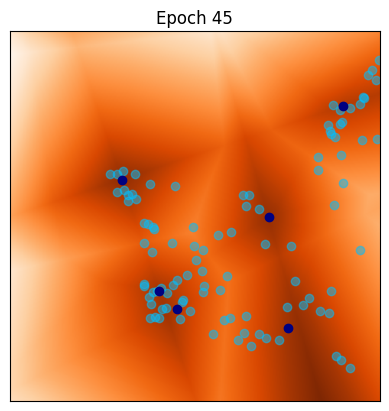

[46/100] 	Loss_D: -0.0702	Loss_G: -45.7206	Lip(D)=1.1181
[47/100] 	Loss_D: -0.0812	Loss_G: -43.7033	Lip(D)=1.1062
[48/100] 	Loss_D: -0.0983	Loss_G: -44.2832	Lip(D)=1.0469
[49/100] 	Loss_D: -0.0913	Loss_G: -42.6222	Lip(D)=1.0297
[50/100] 	Loss_D: -0.1041	Loss_G: -42.2585	Lip(D)=1.1065


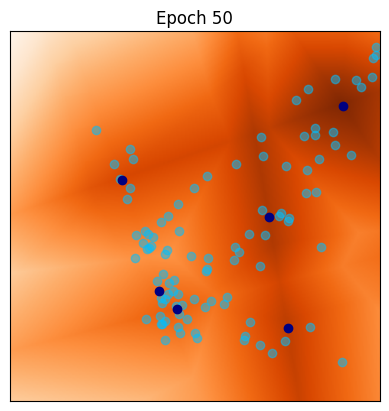

[51/100] 	Loss_D: -0.0742	Loss_G: -46.1228	Lip(D)=1.0754
[52/100] 	Loss_D: -0.0845	Loss_G: -50.8232	Lip(D)=1.1024
[53/100] 	Loss_D: -0.0839	Loss_G: -50.8796	Lip(D)=1.0595
[54/100] 	Loss_D: -0.0841	Loss_G: -52.1650	Lip(D)=1.1044
[55/100] 	Loss_D: -0.0854	Loss_G: -52.0657	Lip(D)=1.0970


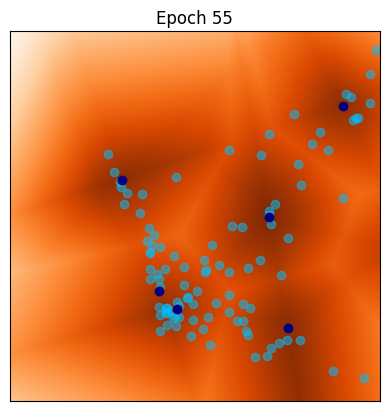

[56/100] 	Loss_D: -0.0848	Loss_G: -53.8597	Lip(D)=1.0578
[57/100] 	Loss_D: -0.1038	Loss_G: -52.9516	Lip(D)=1.0604
[58/100] 	Loss_D: -0.0850	Loss_G: -51.8654	Lip(D)=1.0704
[59/100] 	Loss_D: -0.0798	Loss_G: -52.4573	Lip(D)=1.0779
[60/100] 	Loss_D: -0.0991	Loss_G: -56.2542	Lip(D)=1.1391


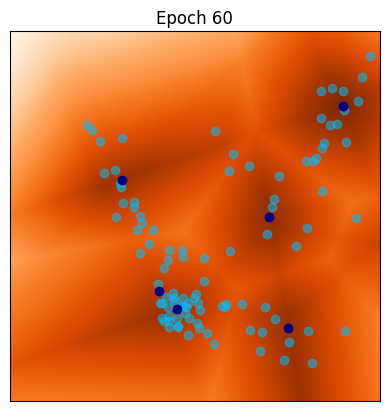

[61/100] 	Loss_D: -0.0856	Loss_G: -58.4392	Lip(D)=1.1106
[62/100] 	Loss_D: -0.0797	Loss_G: -58.5195	Lip(D)=1.1058
[63/100] 	Loss_D: -0.0841	Loss_G: -57.8548	Lip(D)=1.0407
[64/100] 	Loss_D: -0.1000	Loss_G: -58.8409	Lip(D)=1.0955
[65/100] 	Loss_D: -0.0923	Loss_G: -59.3938	Lip(D)=1.0927


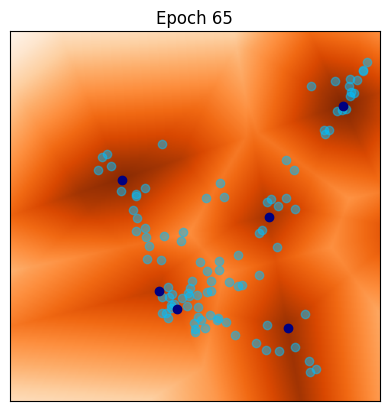

[66/100] 	Loss_D: -0.0776	Loss_G: -59.2911	Lip(D)=1.0220
[67/100] 	Loss_D: -0.0892	Loss_G: -59.4959	Lip(D)=1.0917
[68/100] 	Loss_D: -0.0698	Loss_G: -61.6408	Lip(D)=1.0318
[69/100] 	Loss_D: -0.0878	Loss_G: -62.9718	Lip(D)=1.0577
[70/100] 	Loss_D: -0.0704	Loss_G: -63.0457	Lip(D)=1.0667


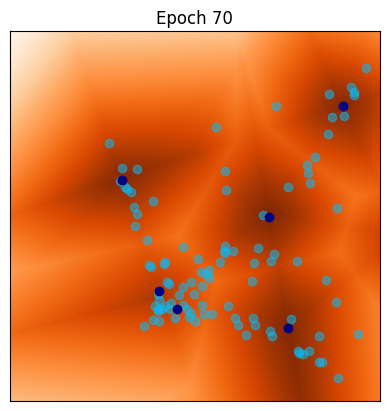

[71/100] 	Loss_D: -0.0775	Loss_G: -62.1170	Lip(D)=1.1082
[72/100] 	Loss_D: -0.0907	Loss_G: -64.4673	Lip(D)=1.0537
[73/100] 	Loss_D: -0.0890	Loss_G: -66.6556	Lip(D)=1.0846
[74/100] 	Loss_D: -0.0696	Loss_G: -66.9527	Lip(D)=1.0826
[75/100] 	Loss_D: -0.0760	Loss_G: -69.1688	Lip(D)=1.0856


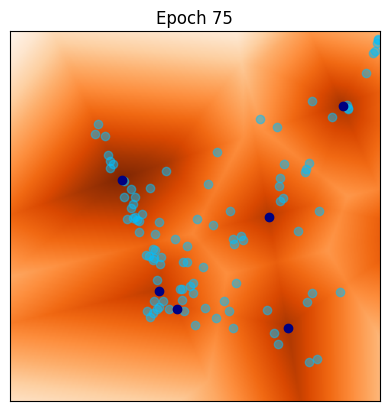

[76/100] 	Loss_D: -0.0903	Loss_G: -68.6178	Lip(D)=1.1026
[77/100] 	Loss_D: -0.0824	Loss_G: -69.0611	Lip(D)=1.1271
[78/100] 	Loss_D: -0.0833	Loss_G: -69.7283	Lip(D)=1.0815
[79/100] 	Loss_D: -0.0807	Loss_G: -70.9937	Lip(D)=1.0741
[80/100] 	Loss_D: -0.0890	Loss_G: -70.9708	Lip(D)=1.0802


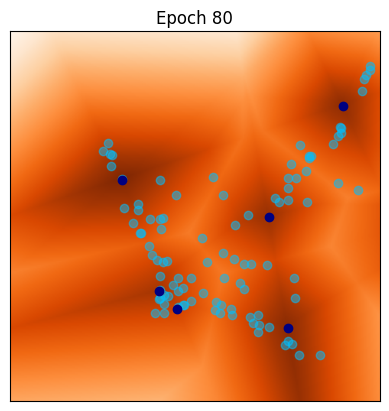

[81/100] 	Loss_D: -0.0872	Loss_G: -68.6200	Lip(D)=1.1249
[82/100] 	Loss_D: -0.0829	Loss_G: -71.1868	Lip(D)=1.1126
[83/100] 	Loss_D: -0.0697	Loss_G: -72.4332	Lip(D)=1.0790
[84/100] 	Loss_D: -0.0885	Loss_G: -70.8684	Lip(D)=1.0644
[85/100] 	Loss_D: -0.0949	Loss_G: -69.5397	Lip(D)=1.1226


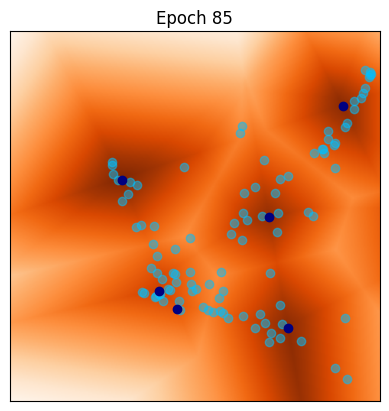

[86/100] 	Loss_D: -0.0622	Loss_G: -70.7126	Lip(D)=1.0805
[87/100] 	Loss_D: -0.0782	Loss_G: -71.7501	Lip(D)=1.2075
[88/100] 	Loss_D: -0.0839	Loss_G: -72.6663	Lip(D)=1.0729
[89/100] 	Loss_D: -0.0741	Loss_G: -73.8811	Lip(D)=1.1170
[90/100] 	Loss_D: -0.0760	Loss_G: -73.8712	Lip(D)=1.1143


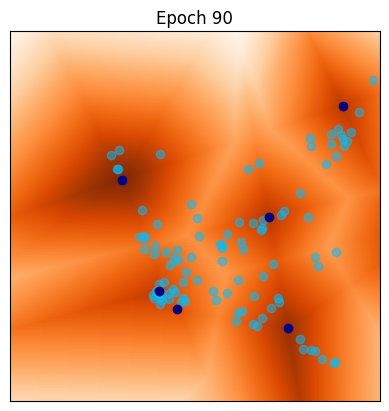

[91/100] 	Loss_D: -0.0873	Loss_G: -74.8179	Lip(D)=1.0418
[92/100] 	Loss_D: -0.0799	Loss_G: -75.1917	Lip(D)=1.0740
[93/100] 	Loss_D: -0.0836	Loss_G: -75.8719	Lip(D)=1.0538
[94/100] 	Loss_D: -0.0894	Loss_G: -75.9637	Lip(D)=1.0674
[95/100] 	Loss_D: -0.0756	Loss_G: -77.4820	Lip(D)=1.0520


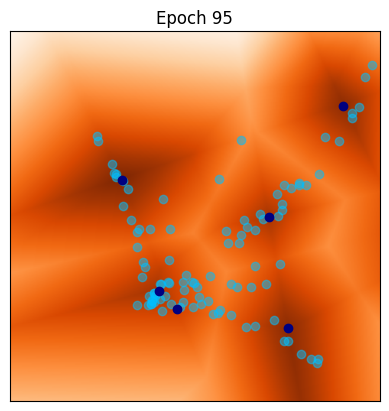

[96/100] 	Loss_D: -0.0920	Loss_G: -76.5250	Lip(D)=1.0042
[97/100] 	Loss_D: -0.0813	Loss_G: -80.6272	Lip(D)=1.0301
[98/100] 	Loss_D: -0.0865	Loss_G: -78.9089	Lip(D)=1.0493
[99/100] 	Loss_D: -0.0783	Loss_G: -78.3762	Lip(D)=1.0790


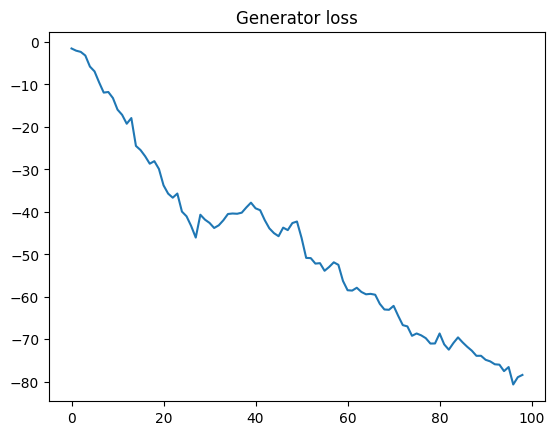

<All keys matched successfully>

In [16]:
### ... ###

## parameters for training
n_epochs = 100
niterD=1000
niterG=10
gpw = .5

lr = 0.002      # learning rate for generator
lrdisc = 0.002  # learning rate for discriminator
beta_1 = 0.5
beta_2 = 0.999

torch.manual_seed(1)  # initialize random seed for reproducibility

# Initialize generators and discriminators
G = Generator(n_in=n_in, n_out=d, n_hid=10, nlayers=3, device=device)
optimG = optim.Adam(G.parameters(), lr=lr)

D = Discriminator(n_in=d, n_hid=10).to(device)
optimD = optim.Adam(D.parameters(), lr=lrdisc, betas=(beta_1, beta_2))


Glosses = []
Dlosses = []

iter_display = 5

# Main loop
for epoch in range(1,n_epochs):

    ############################
    ### Train discriminator (niterD iterations)
    ############################

    for iter in range(0,niterD):
        ### ... ###
        optimD.zero_grad()
        z = torch.randn(b, n_in, device=device)
        x = G(z)
        Dloss = -torch.mean(D(y)) + torch.mean(D(x)) + gpw * gradient_penalty(D,y,x)
        Dloss.backward()

        optimD.step()

        lip = lipconstant(D,x,y)
        lip.detach()
        Dlosst = Dloss.item()
        Dlosses.append(-Dlosst)

    ############################
    ### Train generator (niterG iterations)
    ############################
    for iter in range(0,niterG):
        ### ... ###
        G.zero_grad()
        z = torch.randn(b, n_in, device=device)
        x = G(z)
        Gloss = -torch.mean(D(x))
        Gloss.backward()
        optimG.step()
        lip = lipconstant(D,y,x)
        lip.detach()

    # Output training stats
    print('[%d/%d] \tLoss_D: %.4f\tLoss_G: %.4f\tLip(D)=%.4f'
      % (epoch, n_epochs, Dloss.item(), Gloss.item(),lipconstant(D,x,y).item()))
    Glosses.append(Gloss.item())
    Dlosses.append(Dloss.item())

    if(epoch % iter_display == 0):
        Dxgrid = D(xgrid).detach().cpu().numpy().reshape(nr,nc)
        z = torch.randn(b, n_in, device=device)
        x = G(z)
        xd = x.detach().squeeze(1)
        strtitle = 'Epoch '+str(epoch)
        fig = plt.figure(dpi=100)
        plt.xticks([])
        plt.yticks([])
        plt.imshow(Dxgrid,cmap = 'Oranges', extent=extent)
        plt.scatter(xd[:, 0].cpu(), xd[:,1].cpu(),c='deepskyblue',alpha=.5)
        plt.scatter(y[:, 0].cpu(), y[:,1].cpu(),c='navy')
        plt.title(strtitle)
        plt.show()


plt.figure(dpi=100)
plt.plot(Glosses)
plt.title('Generator loss')
plt.show()

# Save final generator for later use
wgan = Generator(n_in=n_in, n_out=d, n_hid=10, nlayers=3, device=device)
wgan.load_state_dict(G.state_dict())

## Train the generator only

QUESTION: For a fixed discriminator, optimize only the generator only. Can you explain what is happening then?

ANSWER : When optimizing only the generator for a fixed discriminator, the generator is trying to "fool" the discriminator into classifying its generated samples as real. Since the discriminator's parameters are frozen, it acts as a static evaluation function. The generator adjusts its parameters to produce samples that maximize the discriminator's output.

The generator may learn to produce a limited variety of samples, rather than capturing the full diversity of the real data distribution.

[0/1000], -48.360950


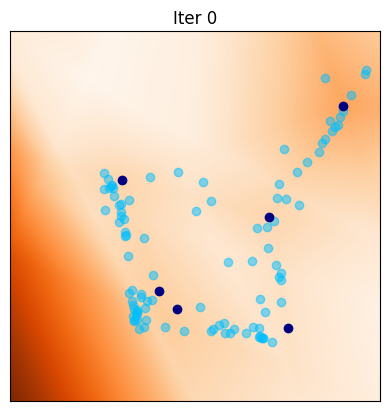

[5/1000], -48.418819


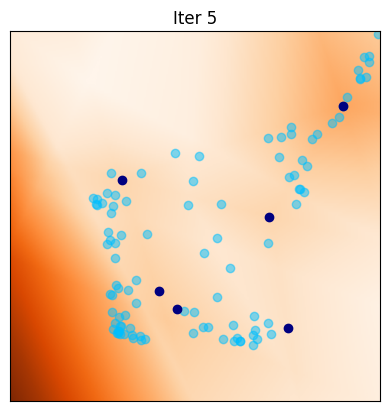

[10/1000], -48.552094


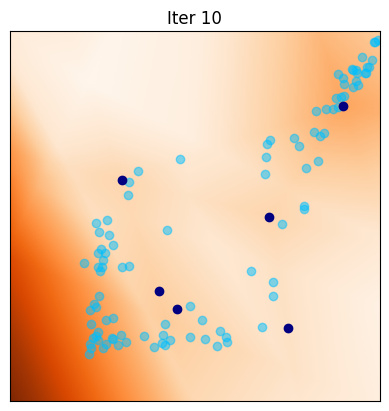

[15/1000], -48.689377


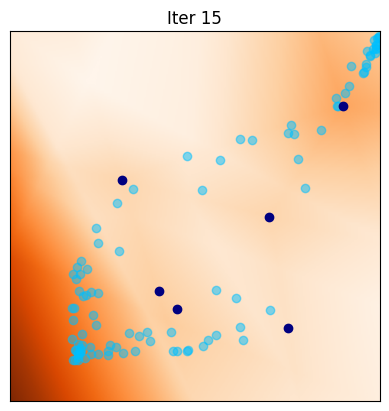

[20/1000], -48.838024


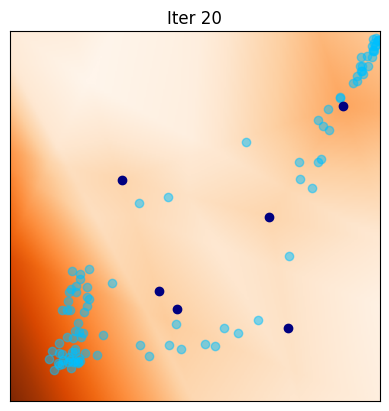

[25/1000], -48.944893


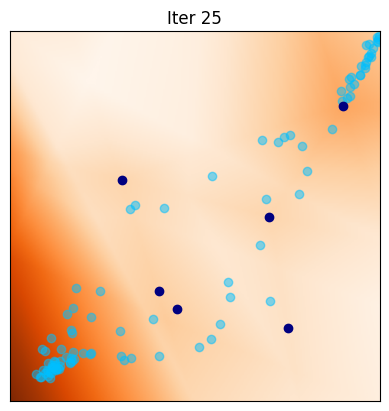

[30/1000], -49.005829


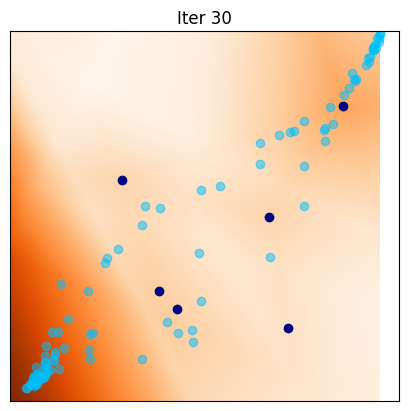

[35/1000], -48.956261


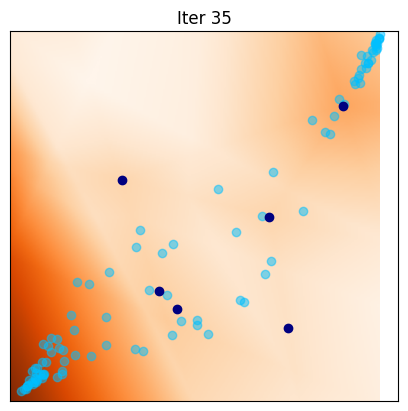

[40/1000], -49.041718


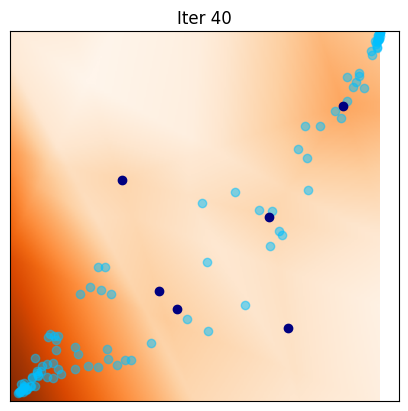

[45/1000], -49.242622


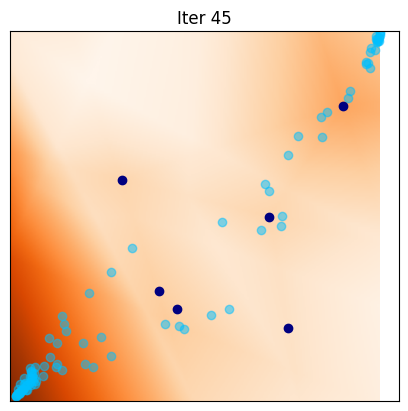

[50/1000], -49.277943


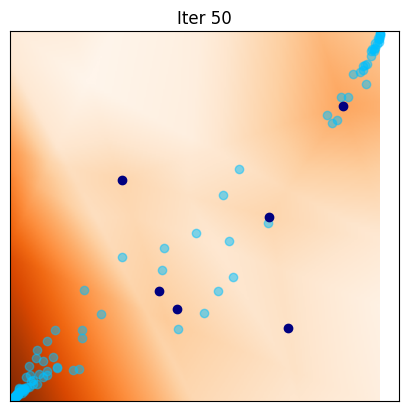

[55/1000], -49.172325


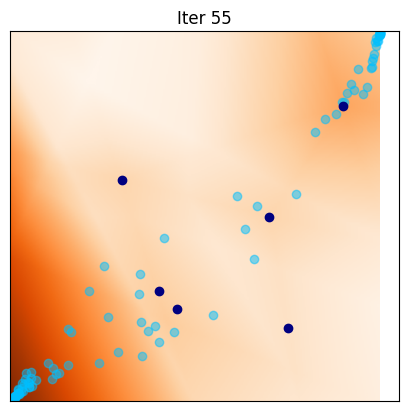

[60/1000], -49.387886


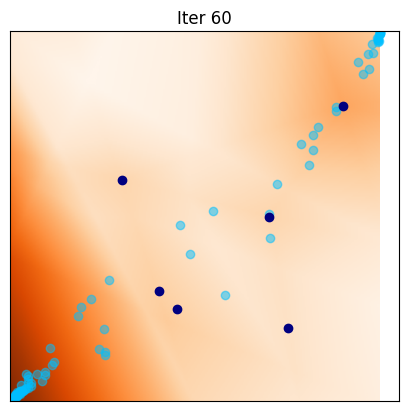

[65/1000], -49.249210


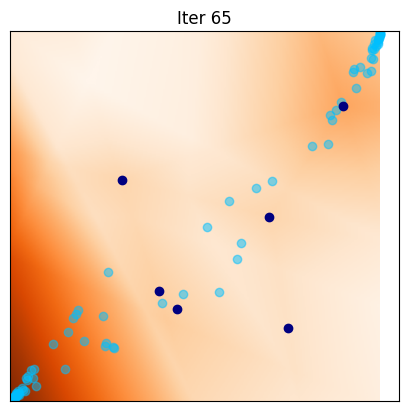

[70/1000], -49.396240


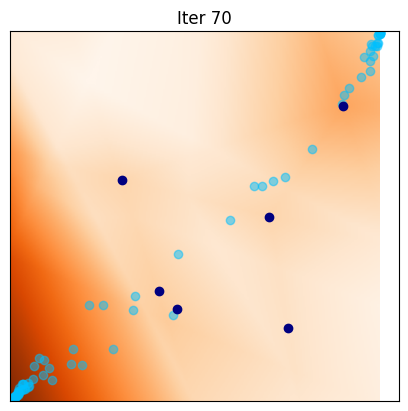

[75/1000], -49.586708


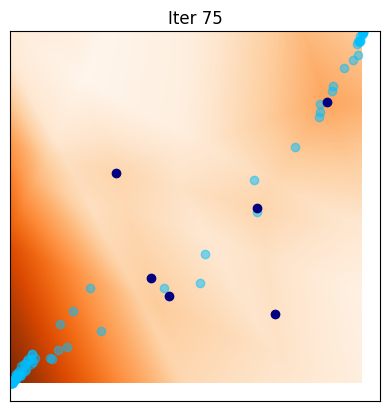

[80/1000], -49.443275


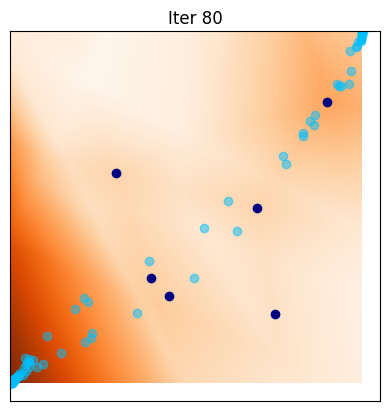

[85/1000], -49.476349


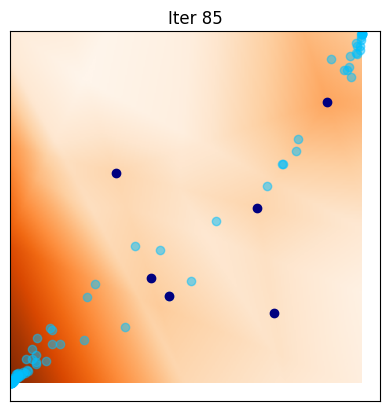

[90/1000], -49.597462


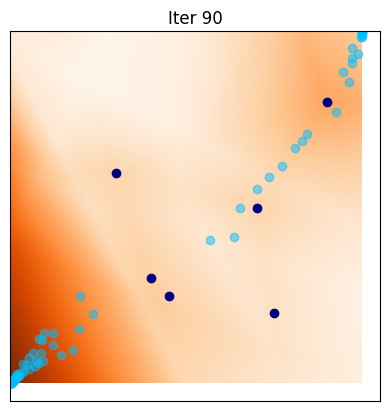

[95/1000], -49.543266


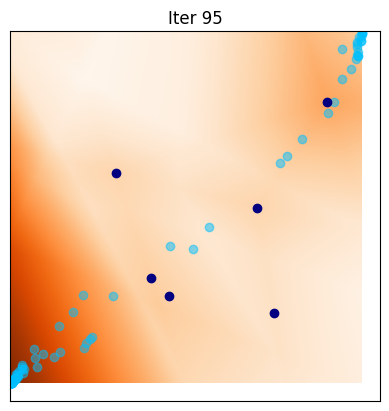

[100/1000], -49.451439


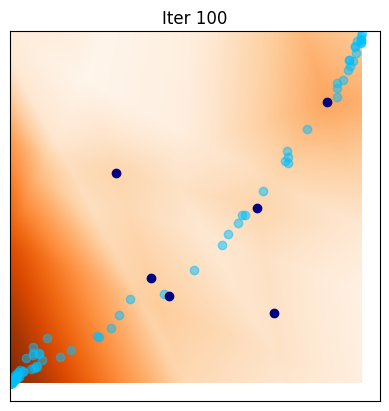

[105/1000], -49.583202


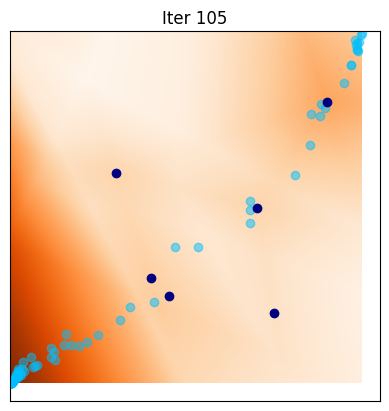

[110/1000], -49.641720


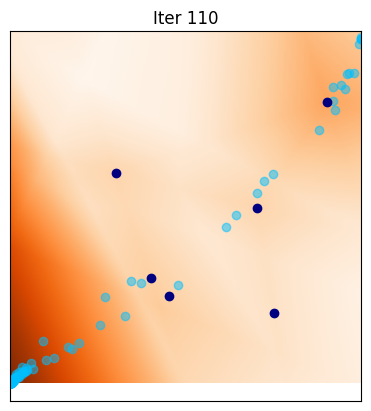

[115/1000], -49.673252


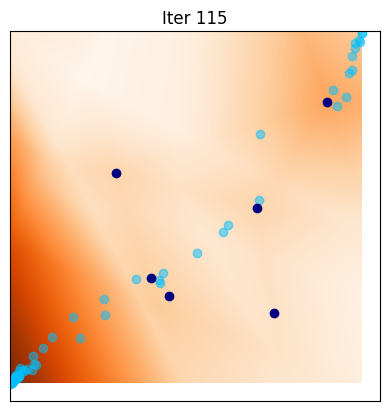

[120/1000], -49.846161


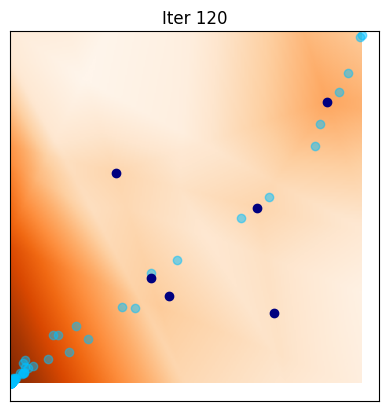

[125/1000], -49.736832


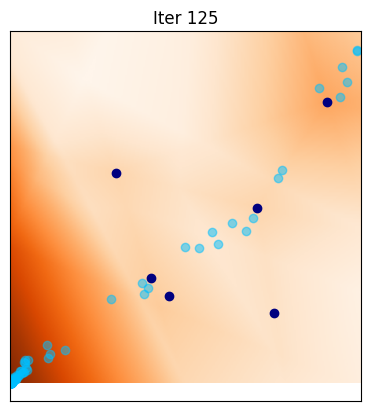

[130/1000], -49.781803


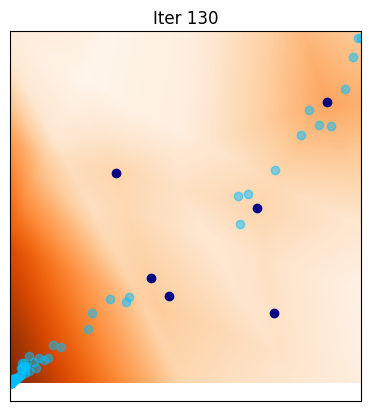

[135/1000], -49.772461


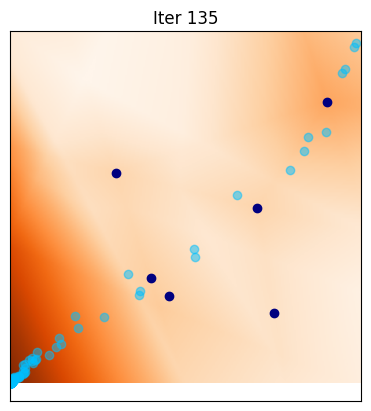

[140/1000], -49.799461


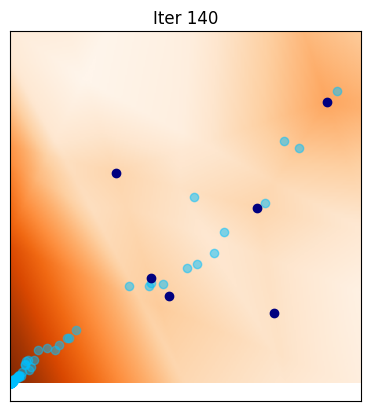

[145/1000], -49.986084


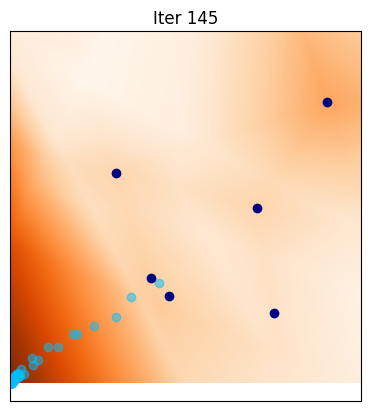

[150/1000], -50.005531


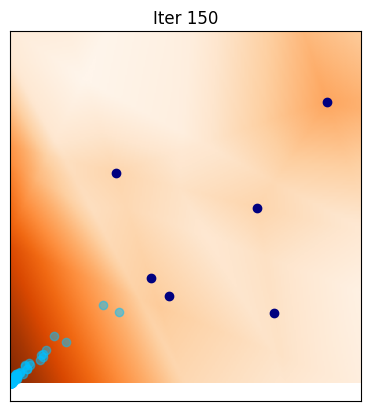

[155/1000], -50.030930


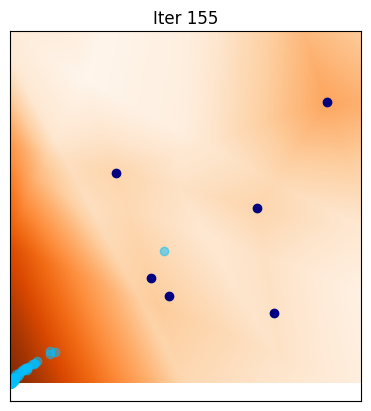

[160/1000], -50.088398


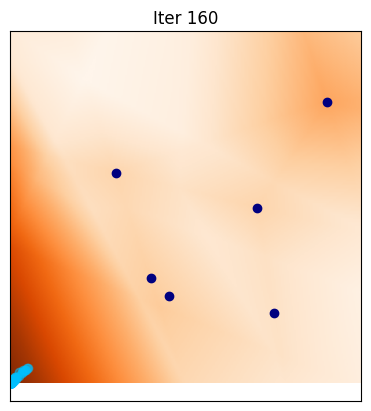

[165/1000], -50.085129


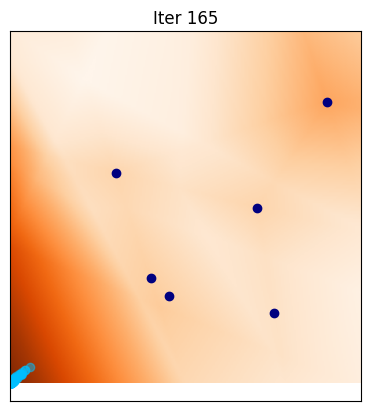

[170/1000], -50.087658


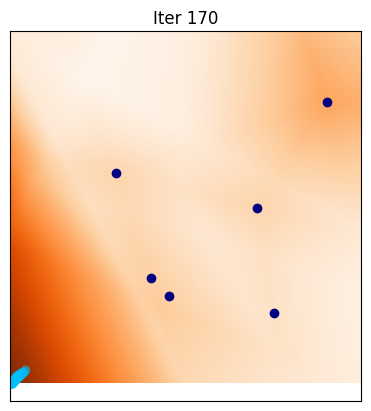

[175/1000], -50.103519


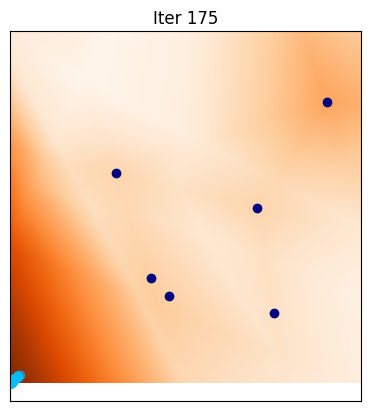

[180/1000], -50.101089


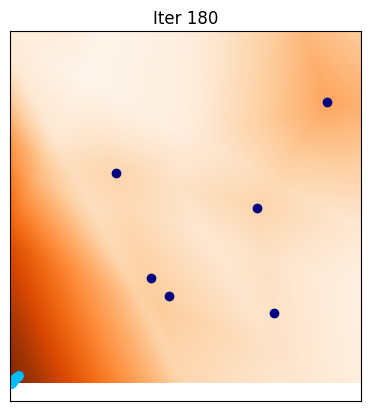

[185/1000], -50.104252


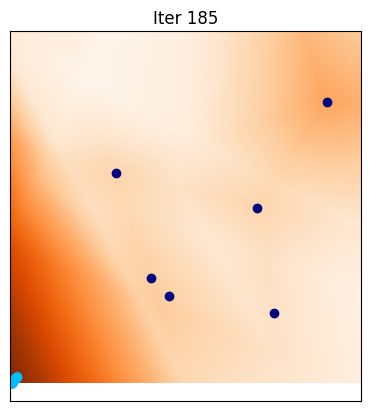

[190/1000], -50.108063


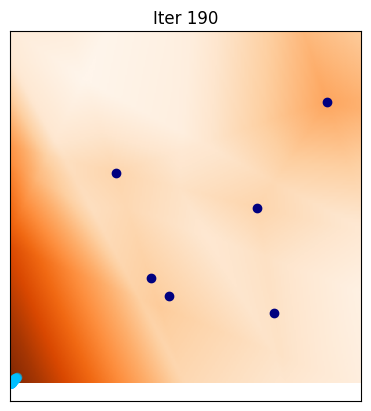

[195/1000], -50.111069


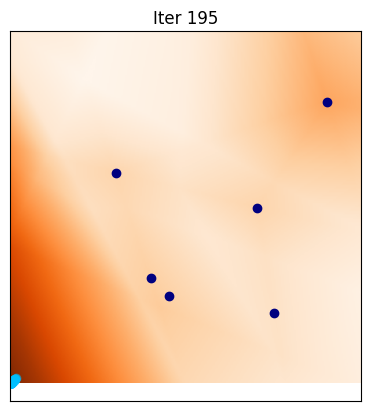

[200/1000], -50.108124


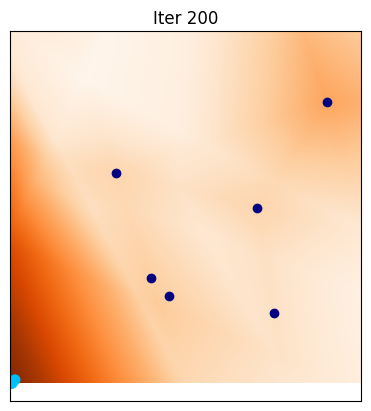

[205/1000], -50.114941


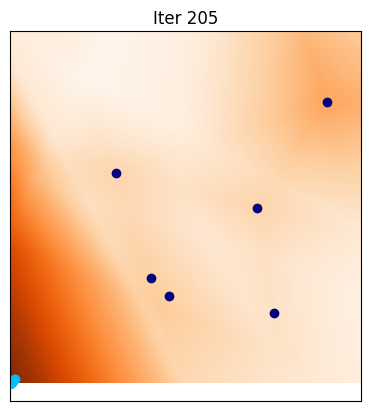

[210/1000], -50.110619


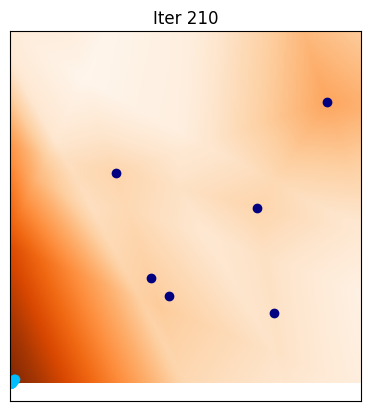

[215/1000], -50.113148


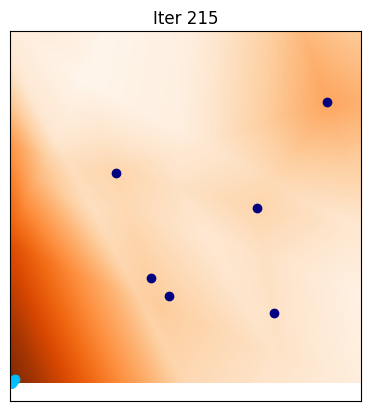

[220/1000], -50.111988


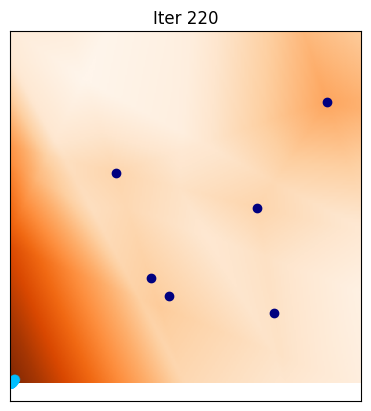

[225/1000], -50.111515


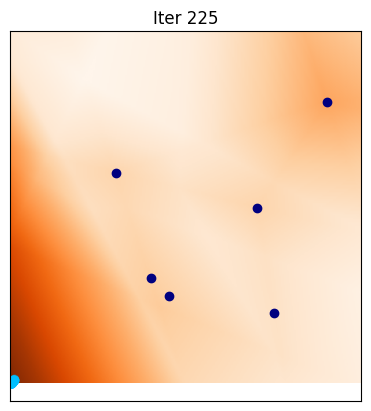

[230/1000], -50.116718


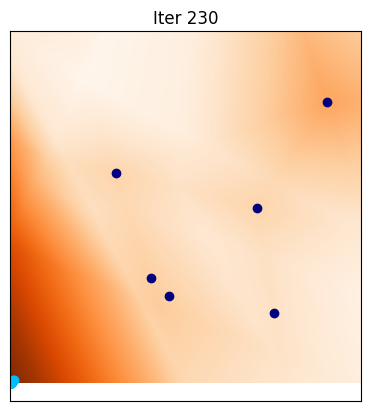

[235/1000], -50.113564


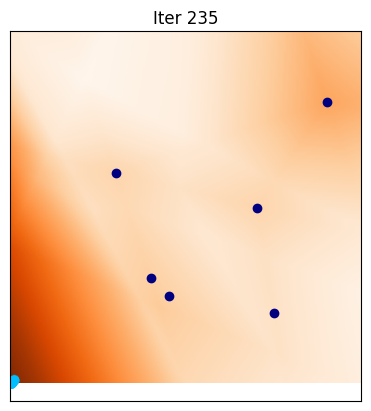

[240/1000], -50.114395


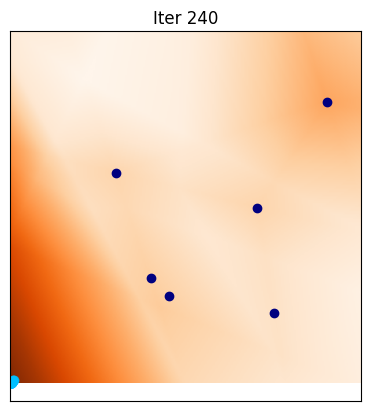

[245/1000], -50.117783


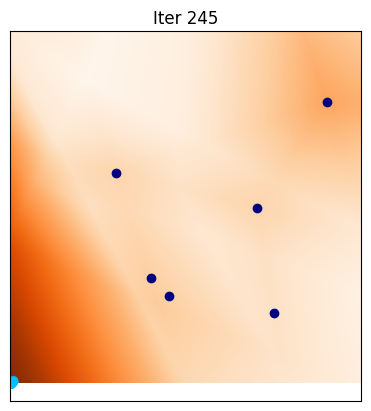

[250/1000], -50.117020


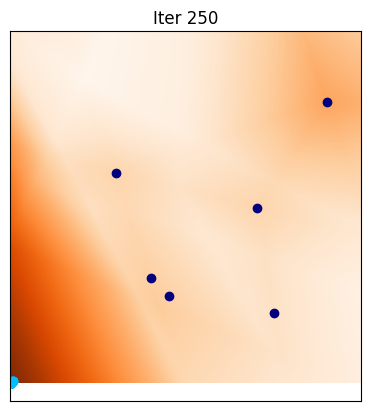

[255/1000], -50.117020


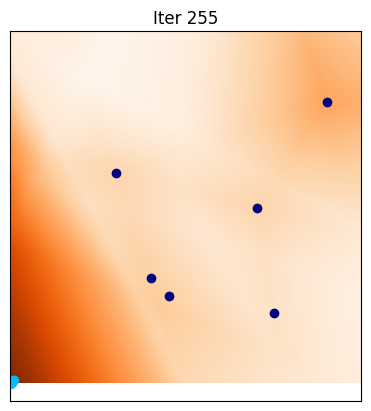

[260/1000], -50.117626


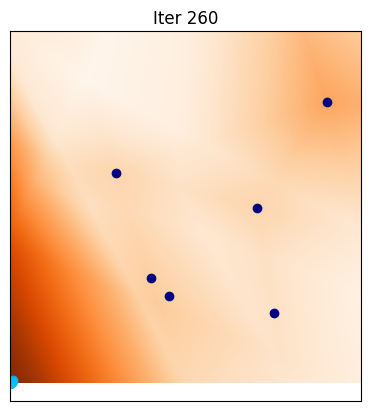

[265/1000], -50.116894


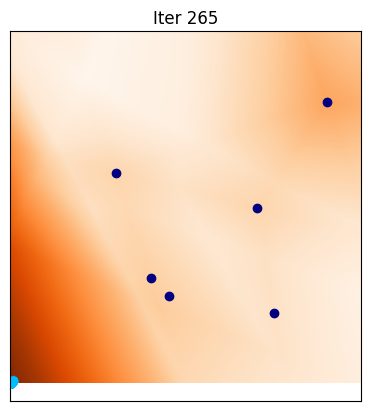

[270/1000], -50.117218


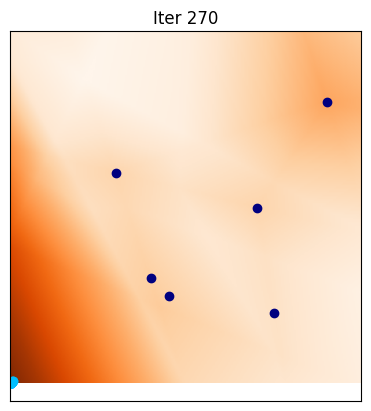

[275/1000], -50.117081


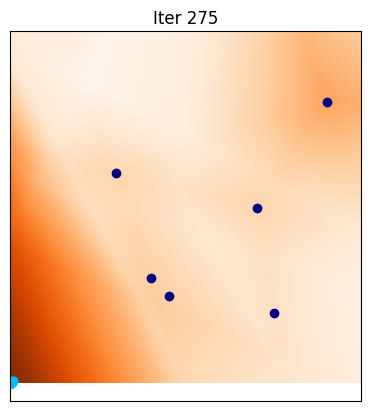

[280/1000], -50.119160


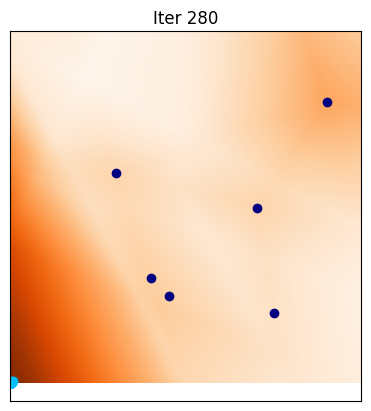

[285/1000], -50.118542


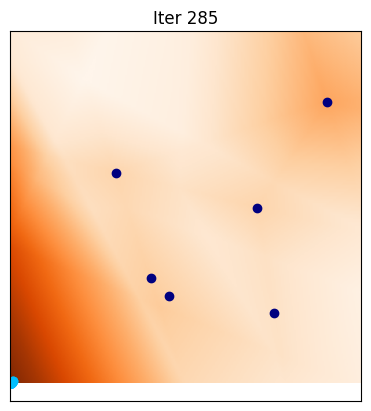

[290/1000], -50.119194


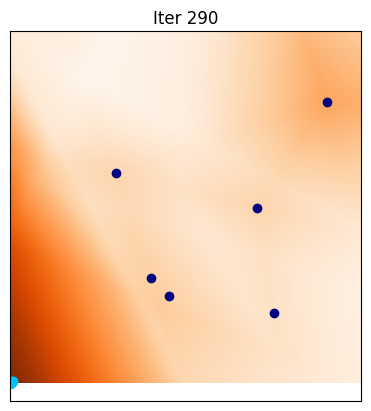

[295/1000], -50.119263


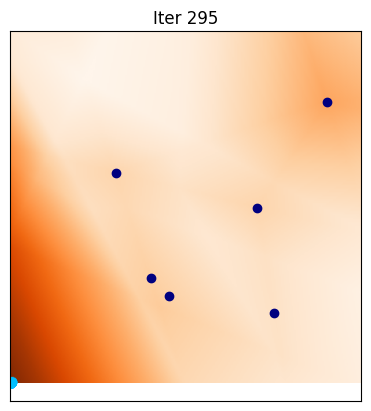

[300/1000], -50.119598


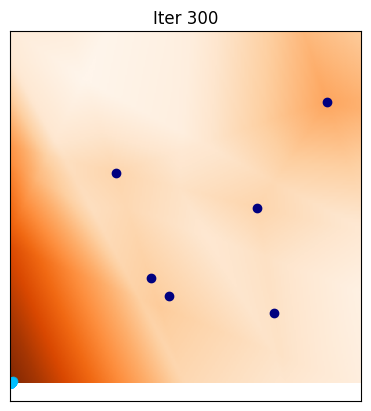

[305/1000], -50.118420


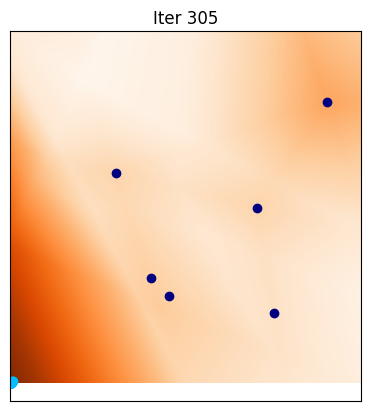

[310/1000], -50.120296


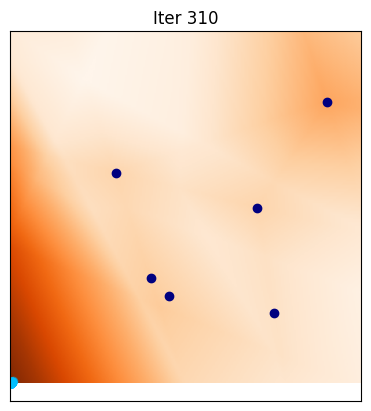

[315/1000], -50.120537


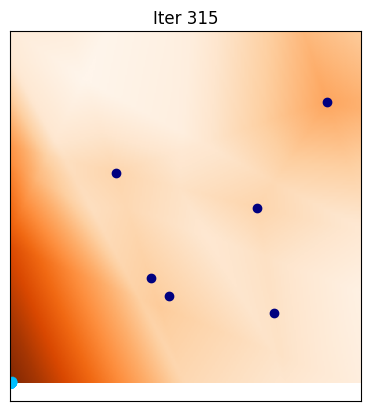

[320/1000], -50.119228


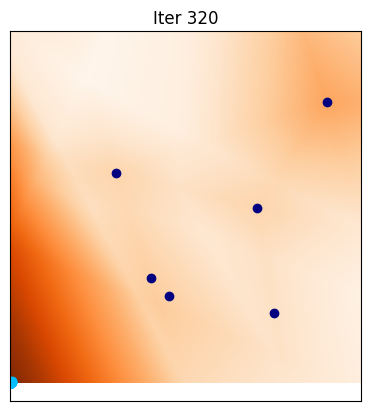

[325/1000], -50.119797


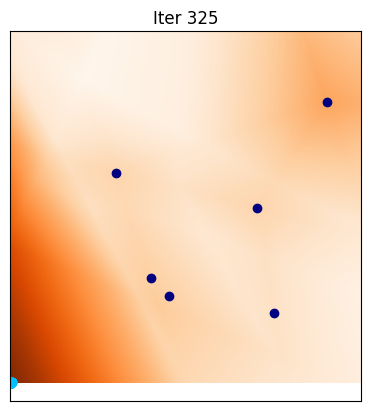

[330/1000], -50.120743


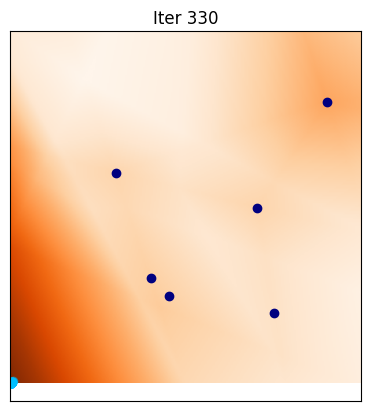

[335/1000], -50.119228


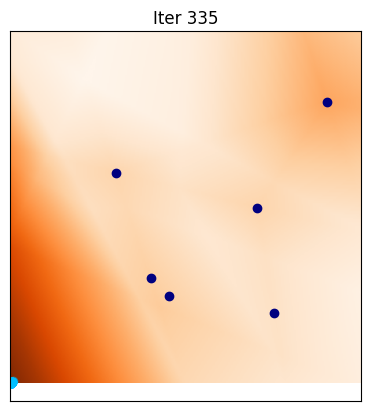

[340/1000], -50.120514


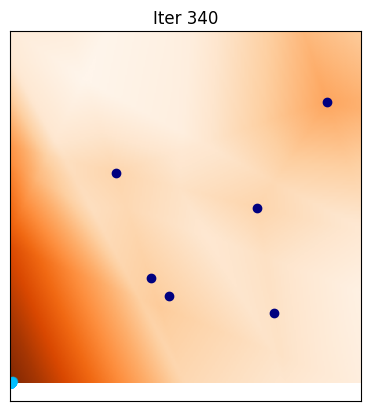

[345/1000], -50.121017


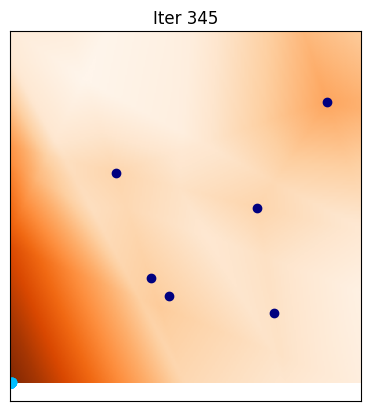

[350/1000], -50.120819


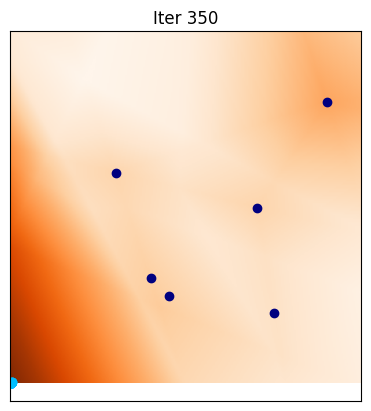

[355/1000], -50.120010


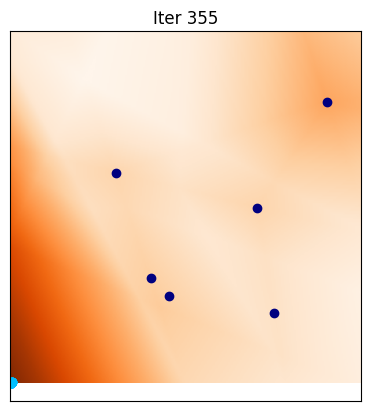

[360/1000], -50.120522


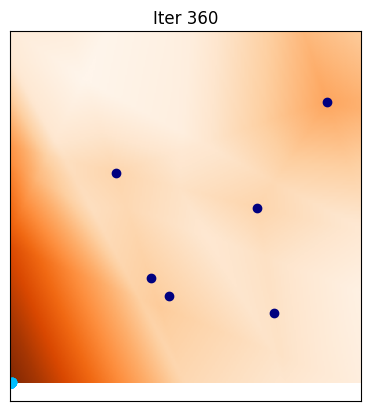

[365/1000], -50.120850


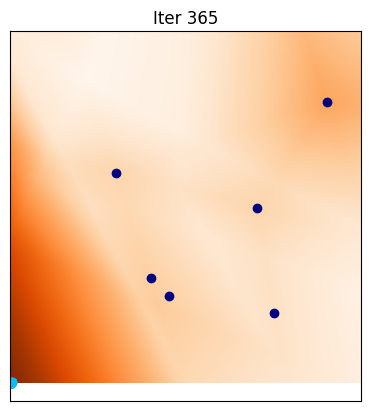

[370/1000], -50.121094


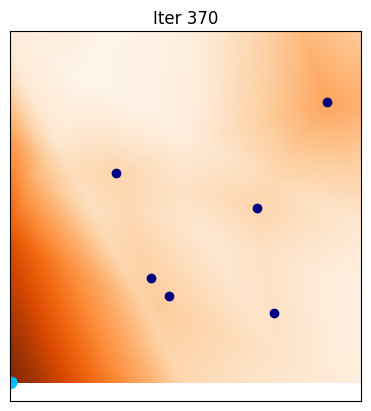

[375/1000], -50.121738


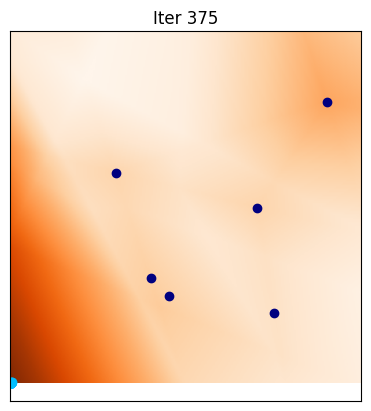

[380/1000], -50.121288


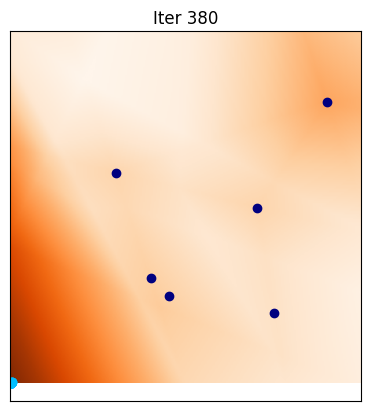

[385/1000], -50.121078


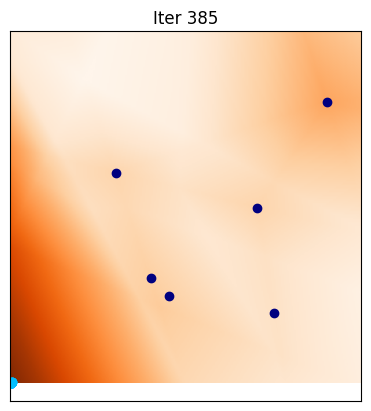

[390/1000], -50.122082


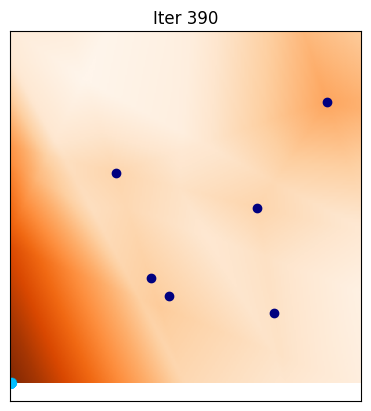

[395/1000], -50.121506


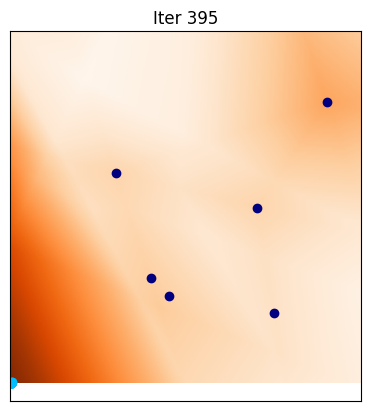

[400/1000], -50.122051


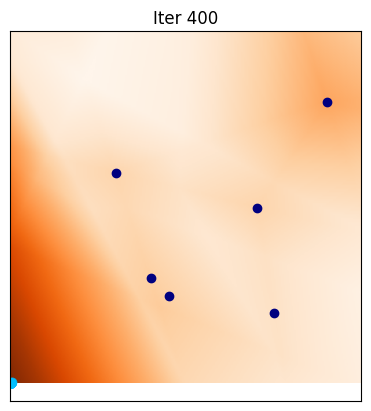

[405/1000], -50.121872


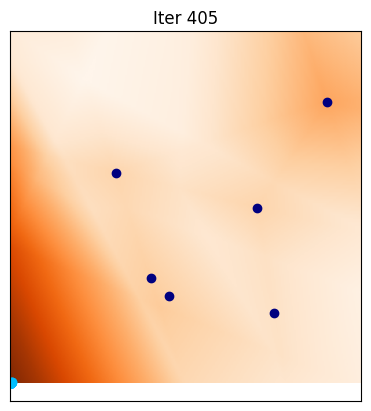

[410/1000], -50.122021


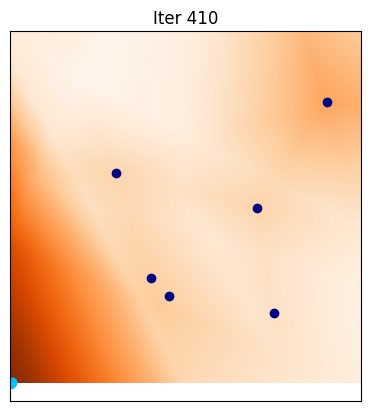

[415/1000], -50.122032


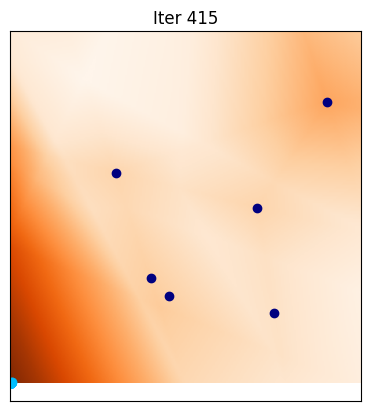

[420/1000], -50.121754


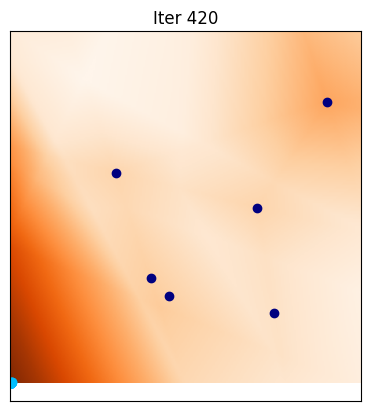

[425/1000], -50.121510


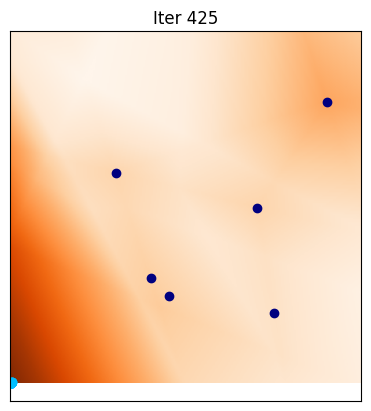

[430/1000], -50.122299


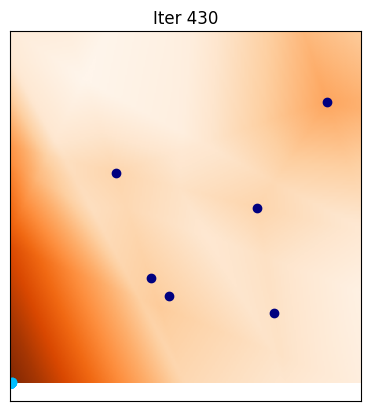

[435/1000], -50.121407


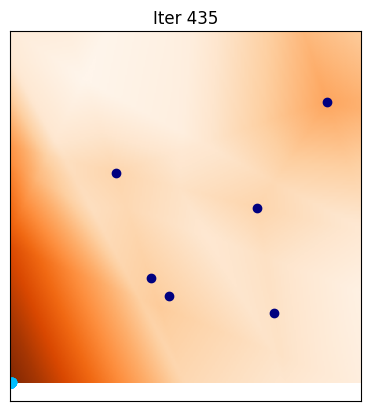

[440/1000], -50.121319


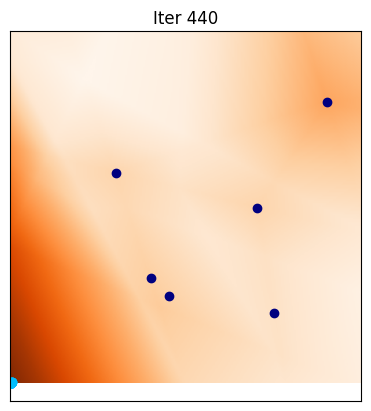

[445/1000], -50.122570


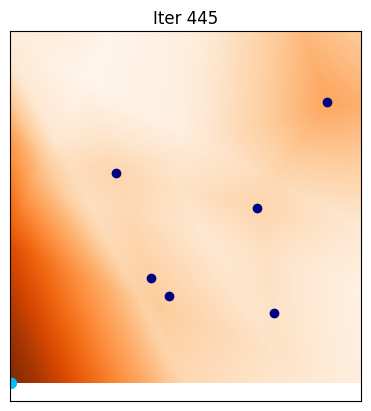

[450/1000], -50.122414


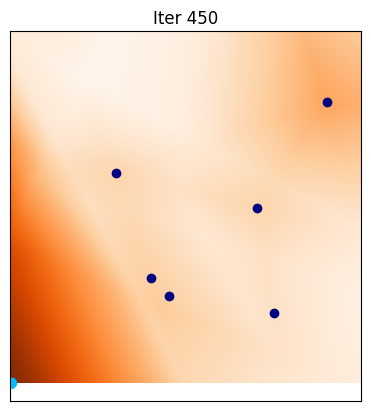

[455/1000], -50.122578


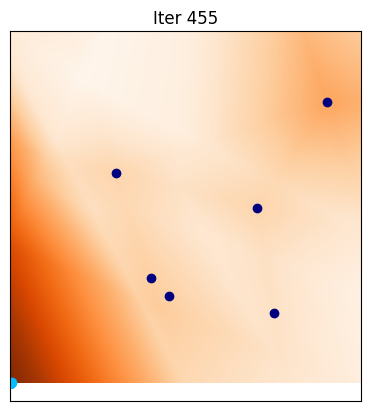

[460/1000], -50.122211


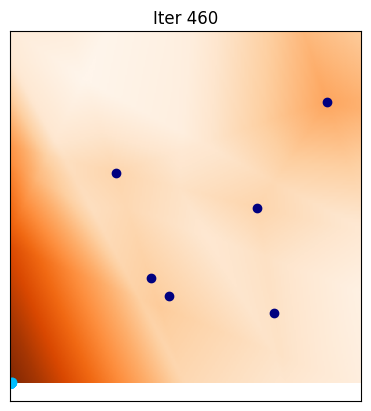

[465/1000], -50.122433


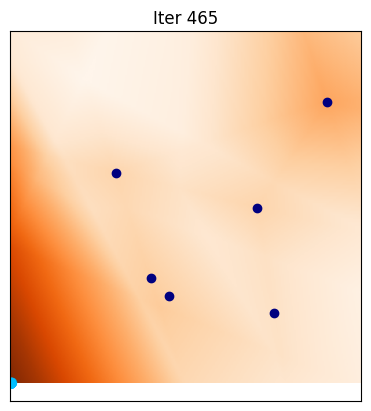

[470/1000], -50.122589


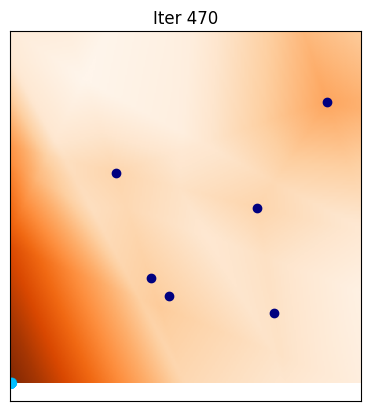

[475/1000], -50.121872


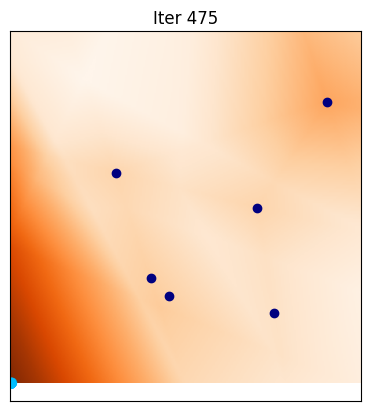

[480/1000], -50.122784


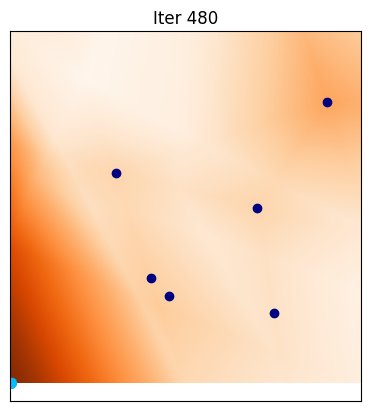

[485/1000], -50.122189


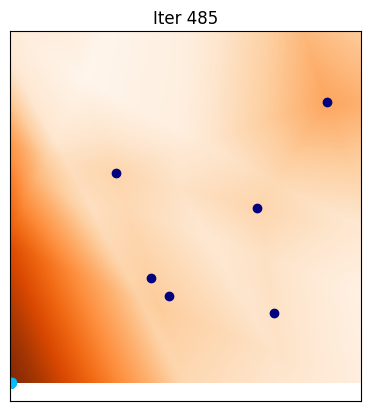

[490/1000], -50.122715


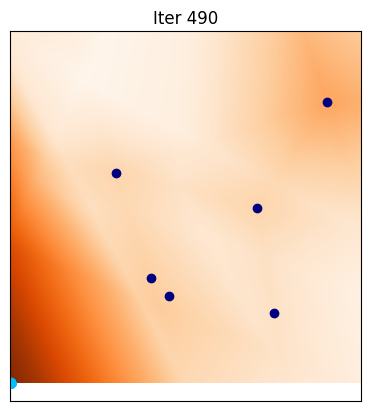

[495/1000], -50.122665


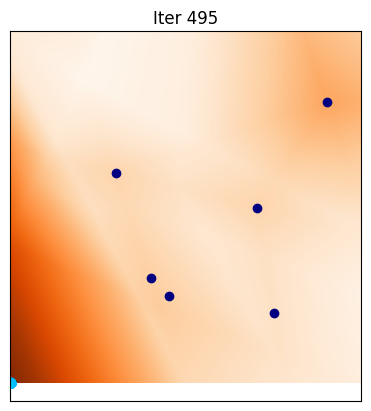

[500/1000], -50.122570


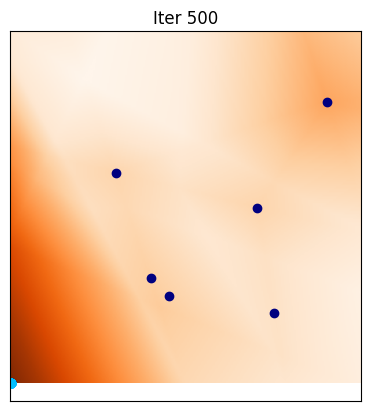

[505/1000], -50.123066


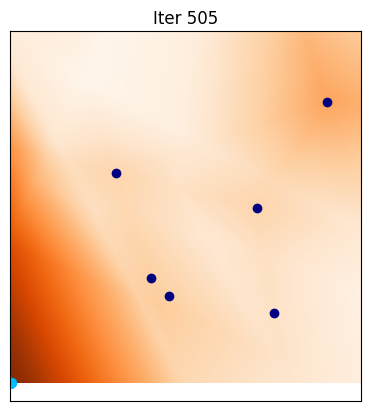

[510/1000], -50.123135


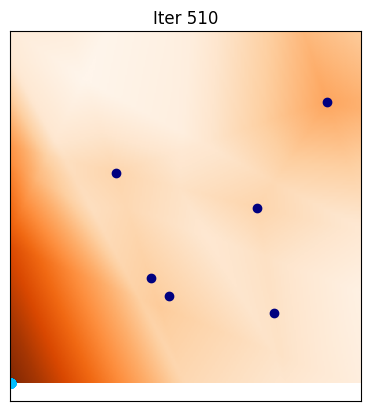

[515/1000], -50.123096


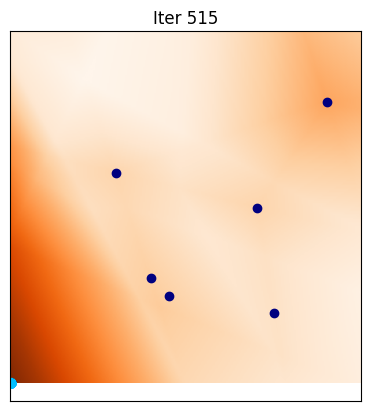

[520/1000], -50.122734


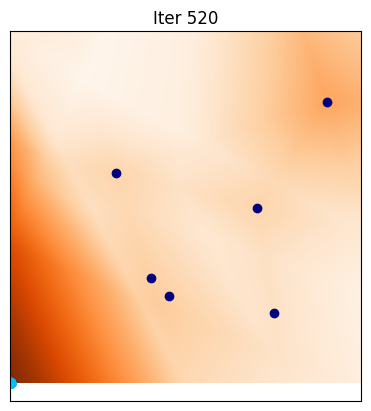

[525/1000], -50.122757


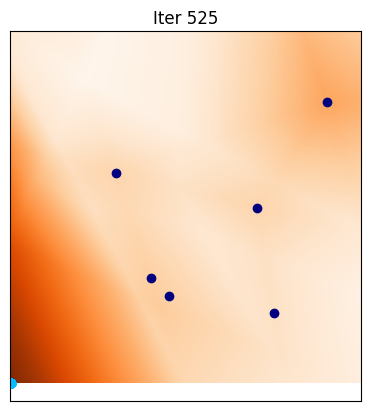

[530/1000], -50.123390


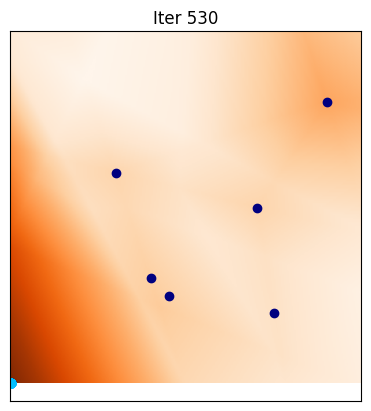

[535/1000], -50.123165


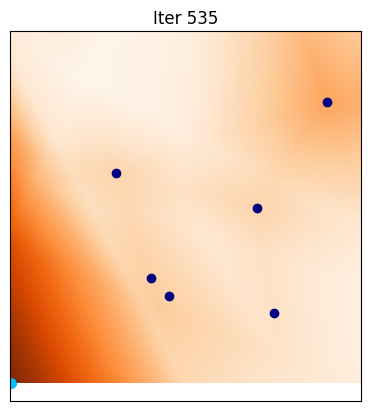

[540/1000], -50.122787


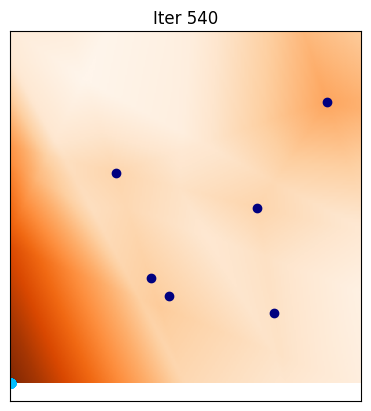

[545/1000], -50.122692


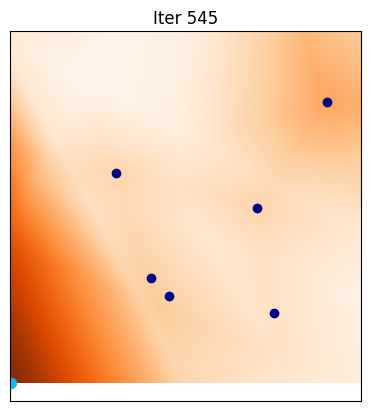

[550/1000], -50.122955


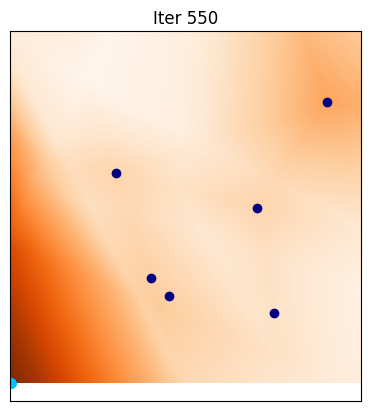

[555/1000], -50.123135


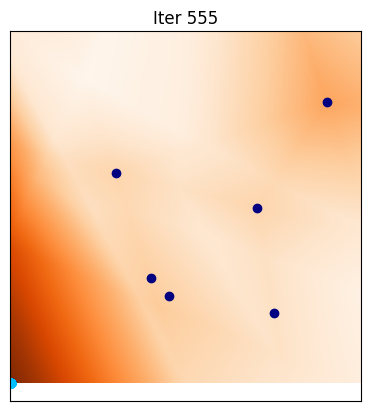

[560/1000], -50.123310


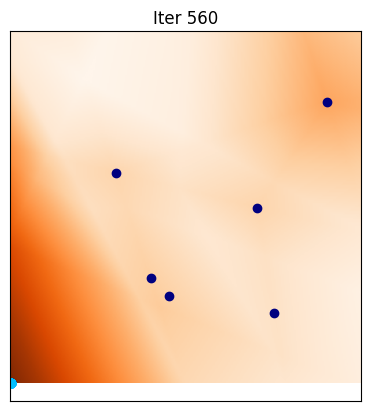

[565/1000], -50.123356


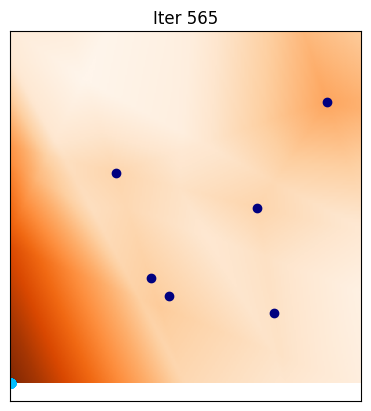

[570/1000], -50.123329


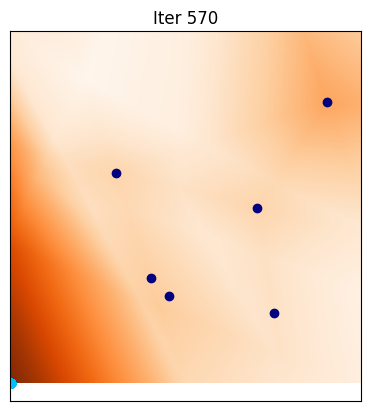

[575/1000], -50.123390


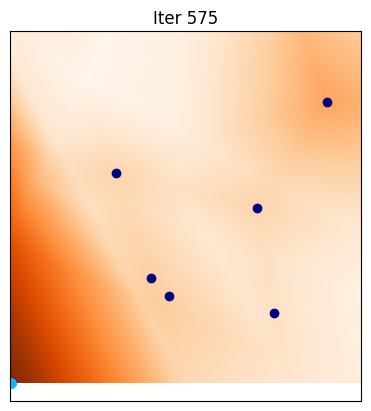

[580/1000], -50.123444


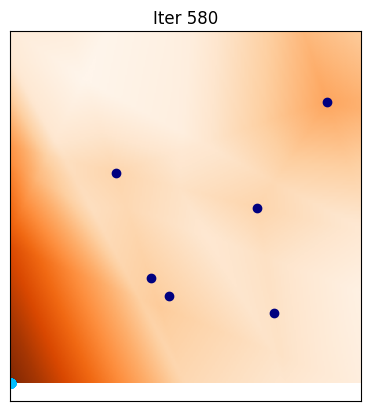

[585/1000], -50.123291


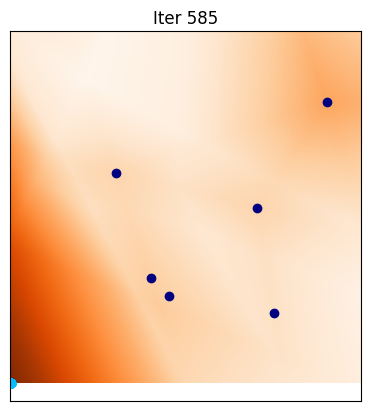

[590/1000], -50.123501


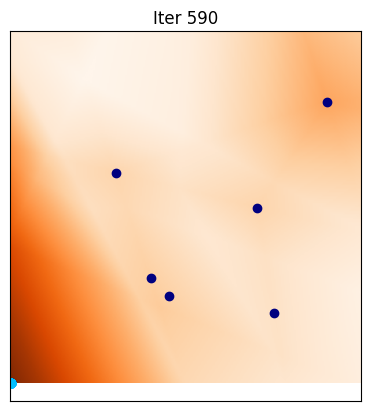

[595/1000], -50.123756


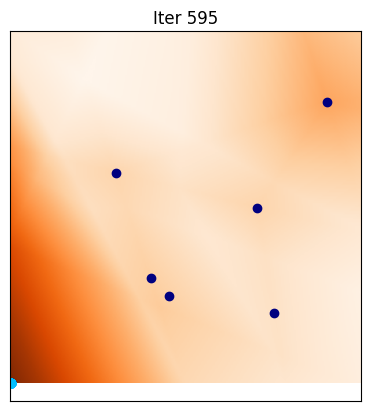

[600/1000], -50.123432


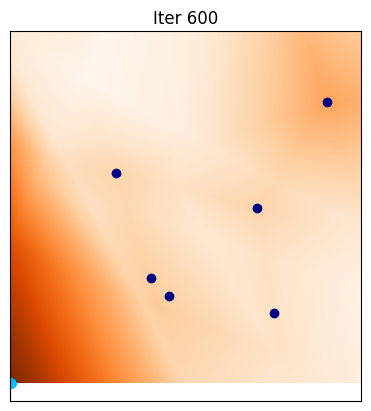

[605/1000], -50.123226


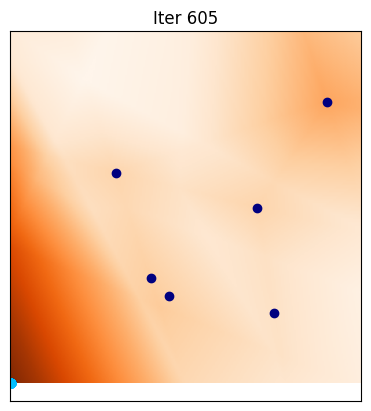

[610/1000], -50.123550


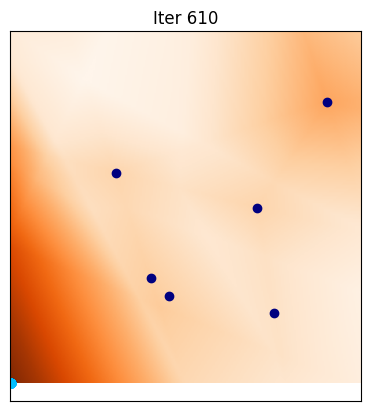

[615/1000], -50.123539


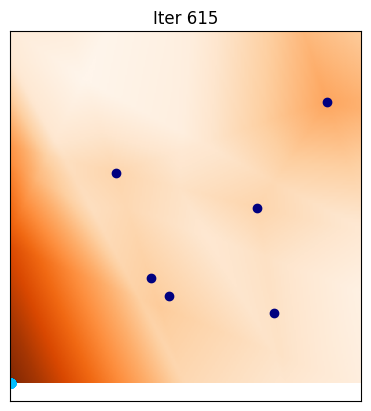

[620/1000], -50.123558


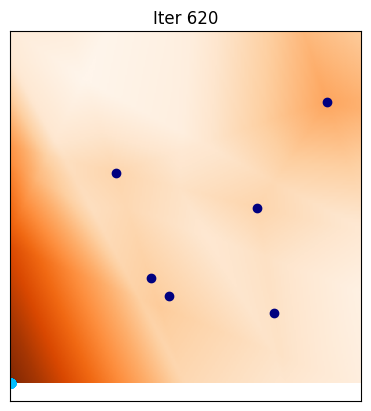

[625/1000], -50.123070


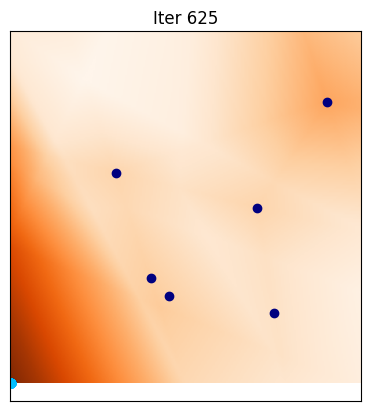

[630/1000], -50.123768


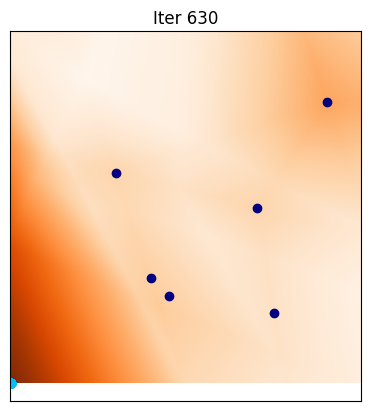

[635/1000], -50.123672


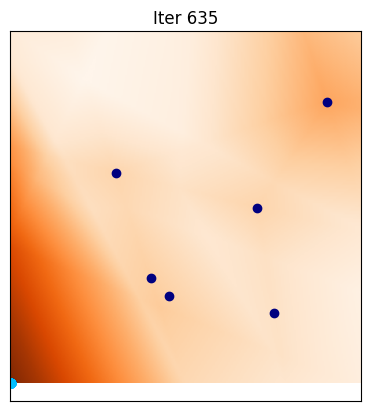

[640/1000], -50.123535


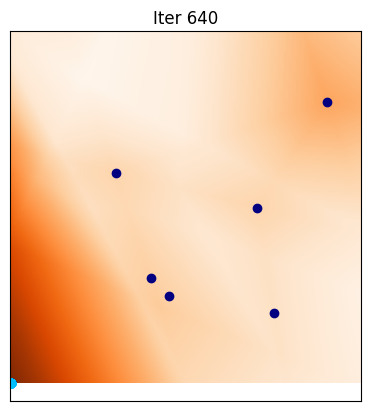

[645/1000], -50.123611


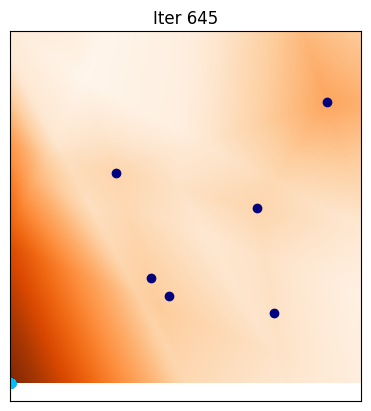

[650/1000], -50.123558


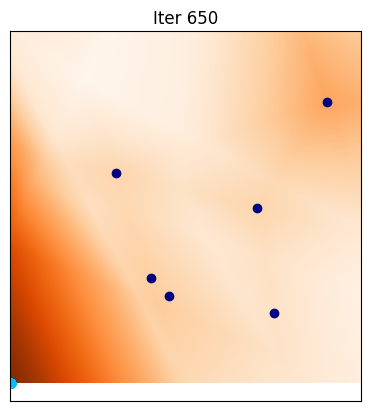

[655/1000], -50.123756


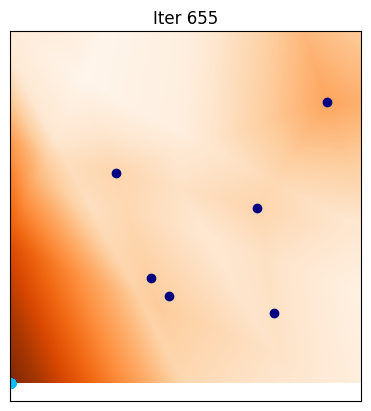

[660/1000], -50.123478


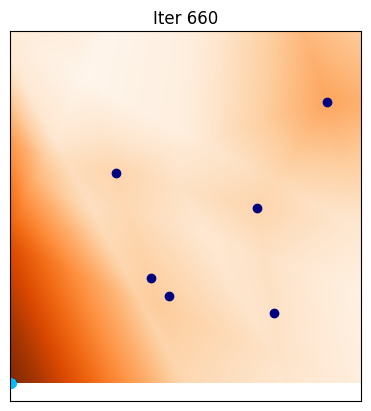

[665/1000], -50.123890


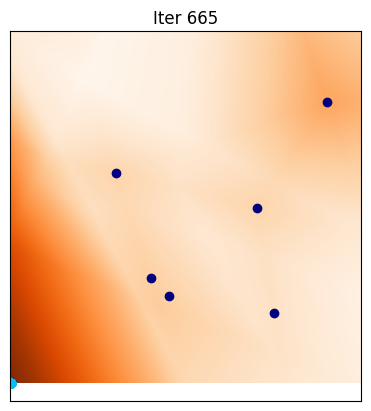

[670/1000], -50.123775


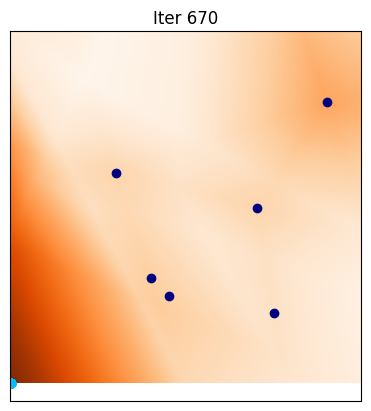

[675/1000], -50.123760


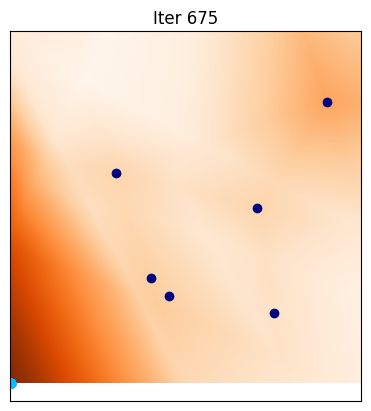

[680/1000], -50.123920


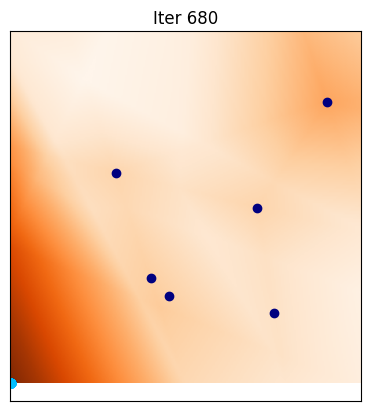

[685/1000], -50.123566


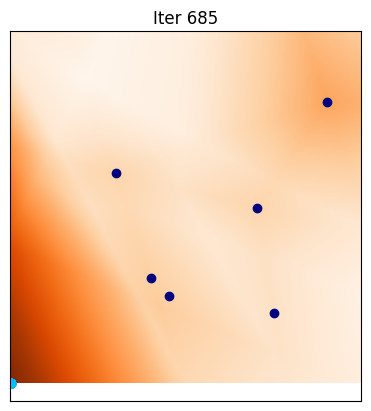

[690/1000], -50.123695


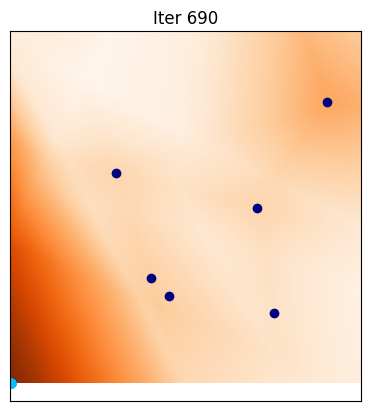

[695/1000], -50.123936


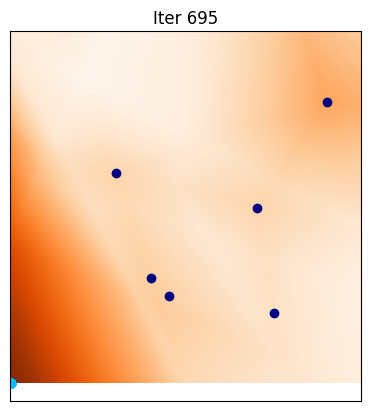

[700/1000], -50.123531


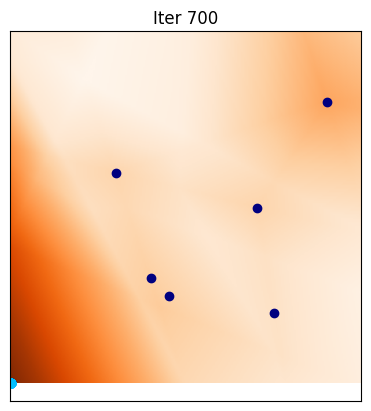

[705/1000], -50.123783


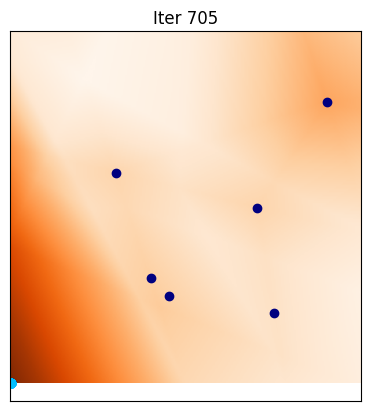

[710/1000], -50.123756


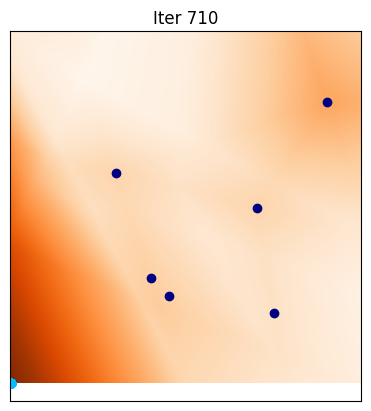

[715/1000], -50.123810


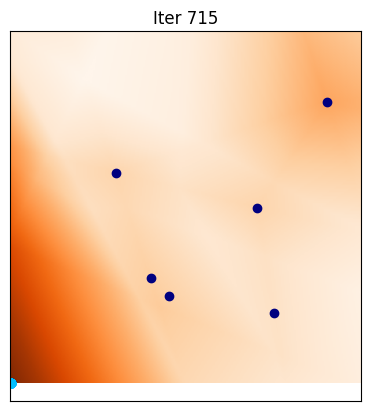

[720/1000], -50.123947


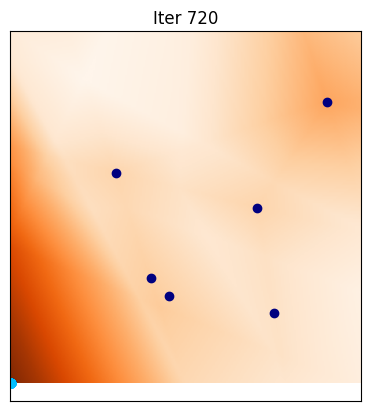

[725/1000], -50.123844


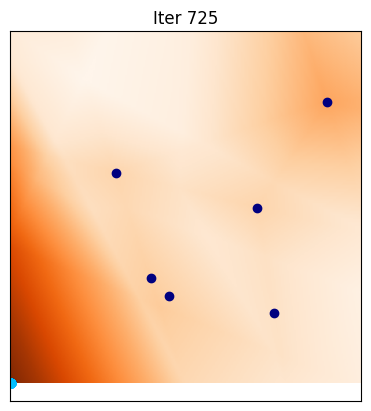

[730/1000], -50.124023


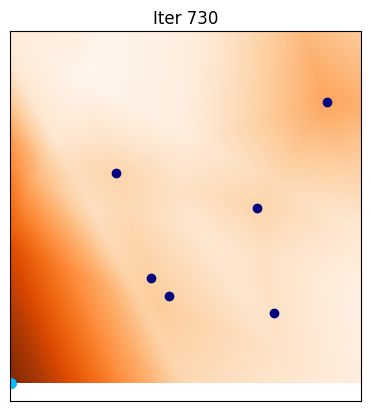

[735/1000], -50.124035


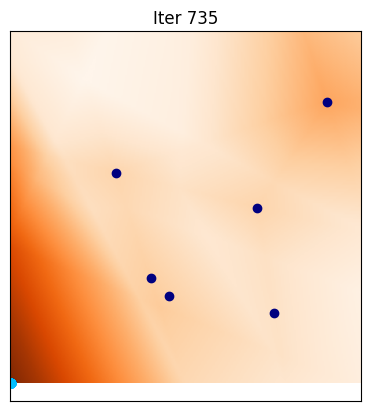

[740/1000], -50.123966


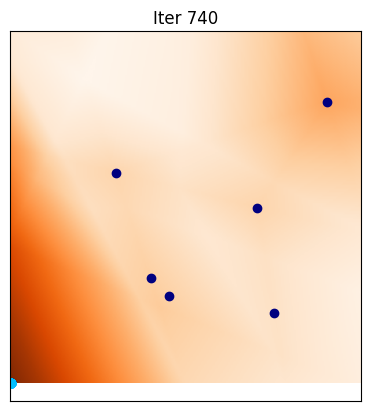

[745/1000], -50.123878


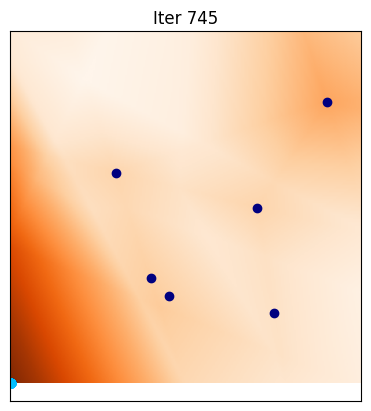

[750/1000], -50.123985


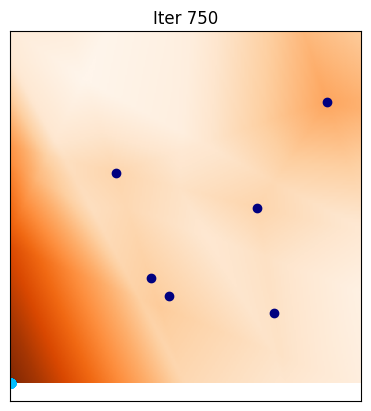

[755/1000], -50.123955


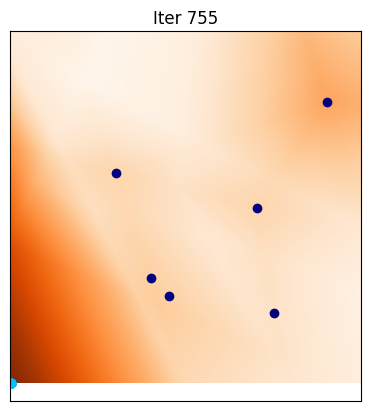

[760/1000], -50.123863


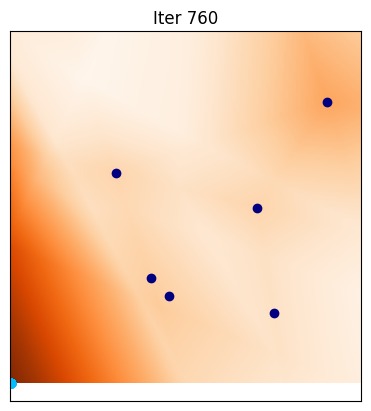

[765/1000], -50.123707


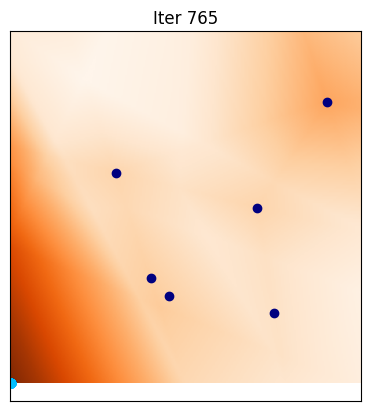

[770/1000], -50.123844


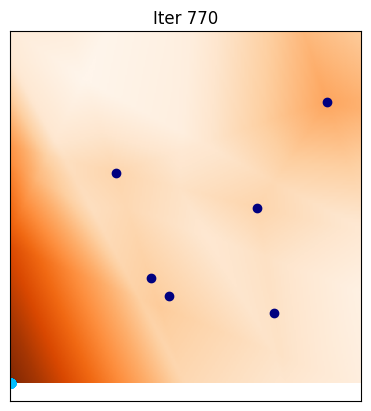

[775/1000], -50.124043


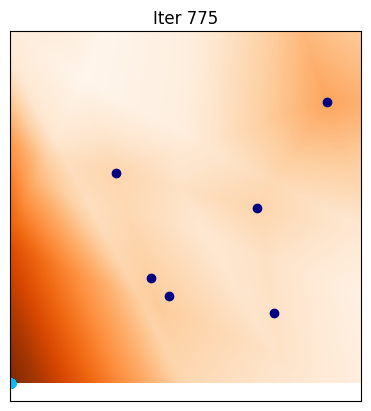

[780/1000], -50.123905


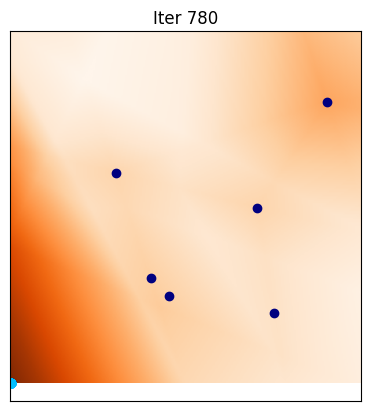

[785/1000], -50.124081


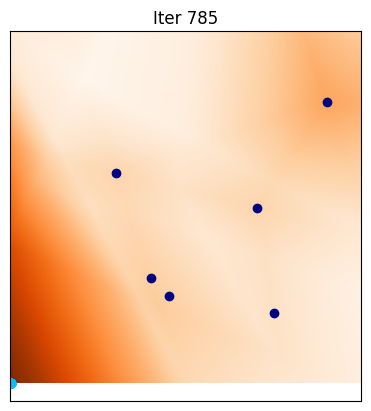

[790/1000], -50.123856


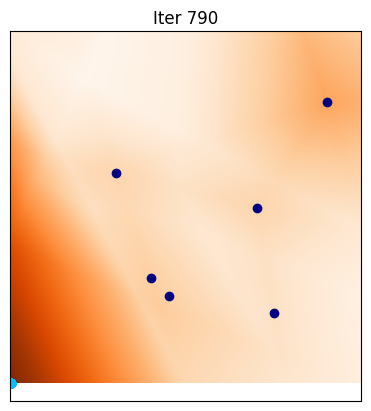

[795/1000], -50.124126


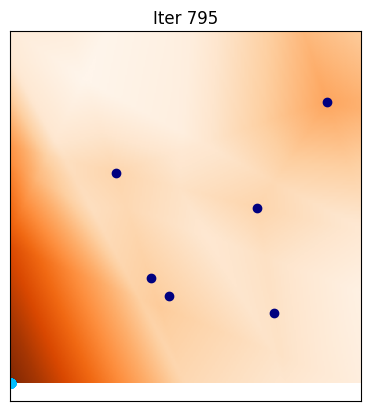

[800/1000], -50.124100


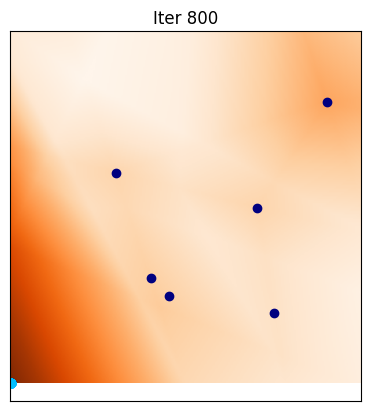

[805/1000], -50.124123


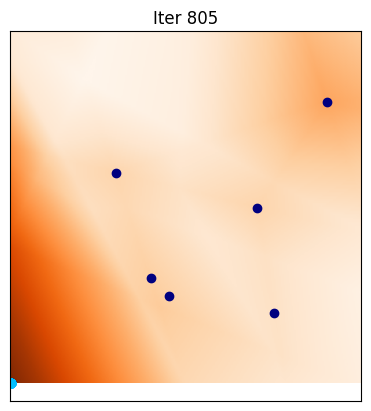

[810/1000], -50.124077


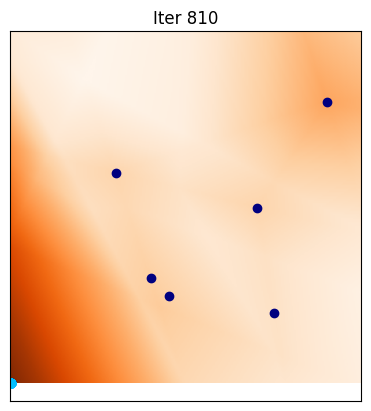

[815/1000], -50.124203


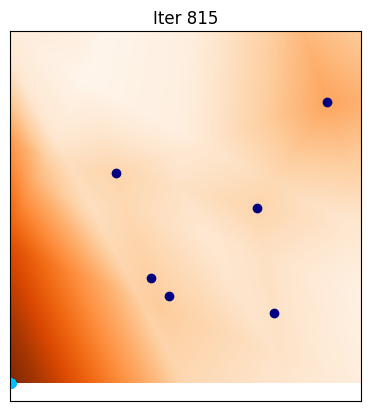

[820/1000], -50.124115


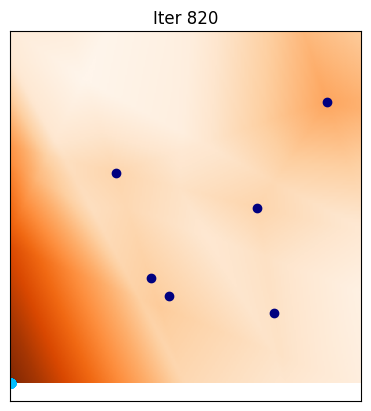

[825/1000], -50.123989


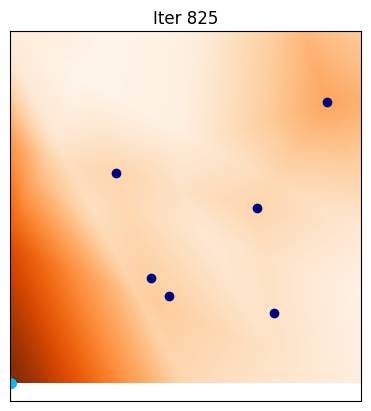

[830/1000], -50.124043


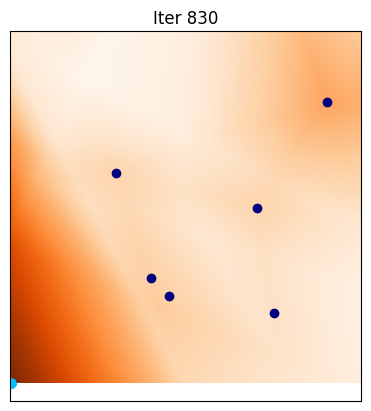

[835/1000], -50.124264


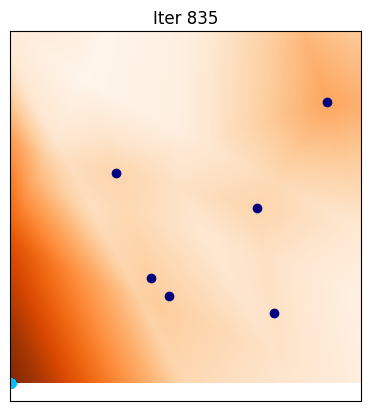

[840/1000], -50.124012


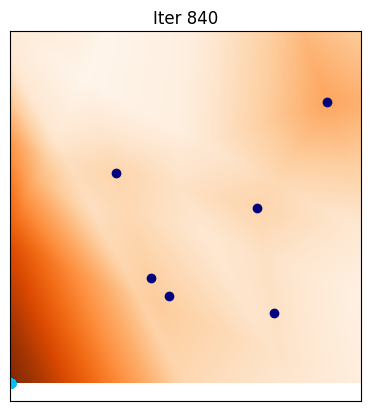

[845/1000], -50.124218


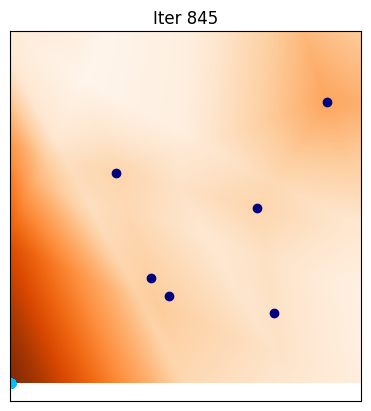

[850/1000], -50.123867


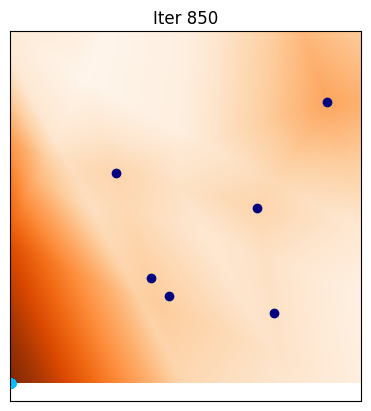

[855/1000], -50.124222


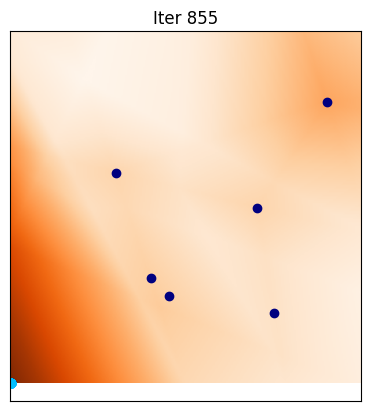

[860/1000], -50.124249


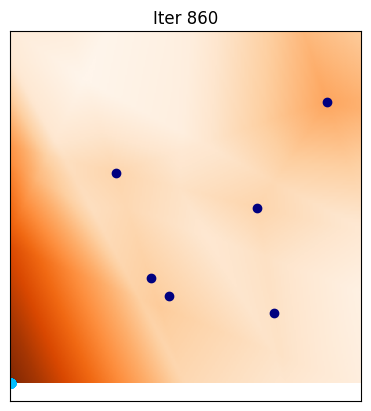

[865/1000], -50.124176


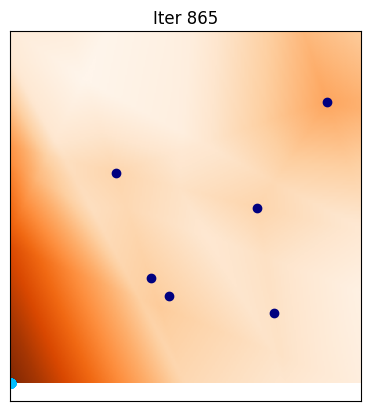

[870/1000], -50.124306


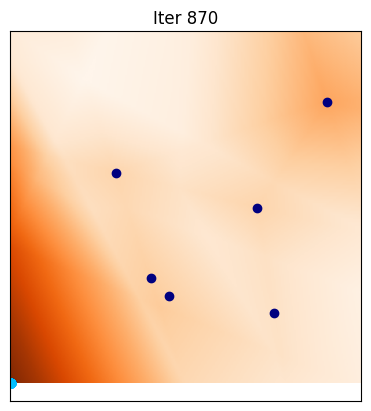

[875/1000], -50.124203


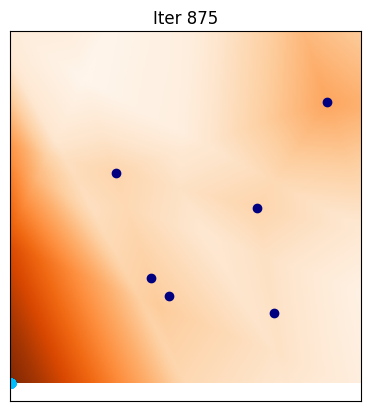

[880/1000], -50.124203


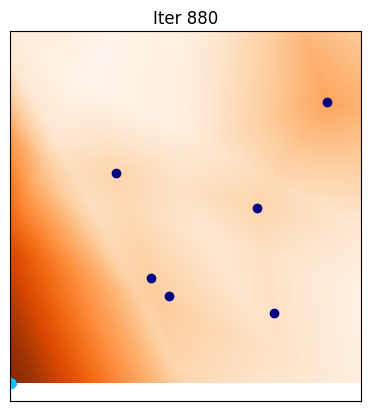

[885/1000], -50.124229


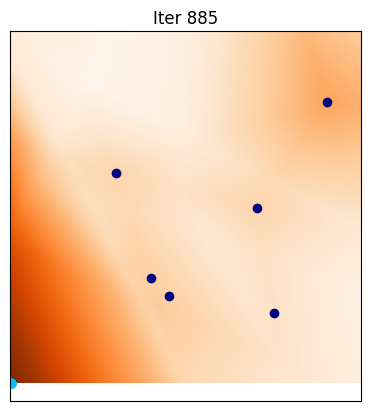

[890/1000], -50.124092


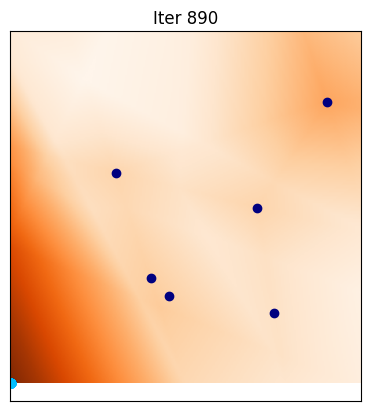

[895/1000], -50.124199


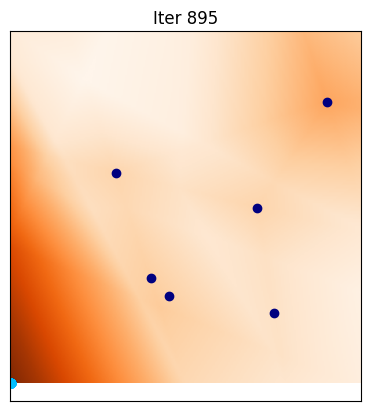

[900/1000], -50.124283


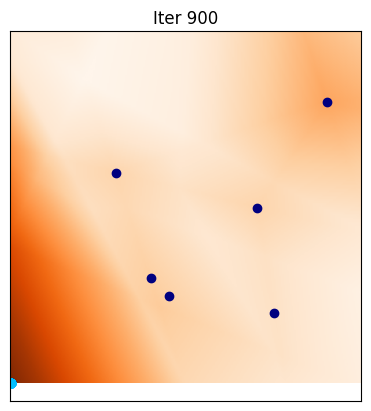

[905/1000], -50.124290


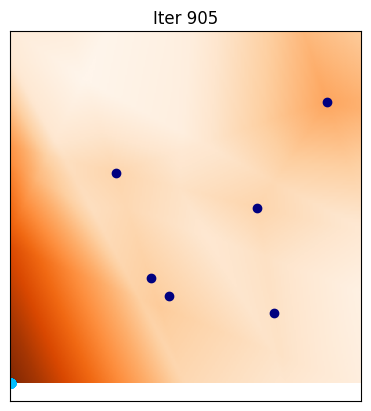

[910/1000], -50.124298


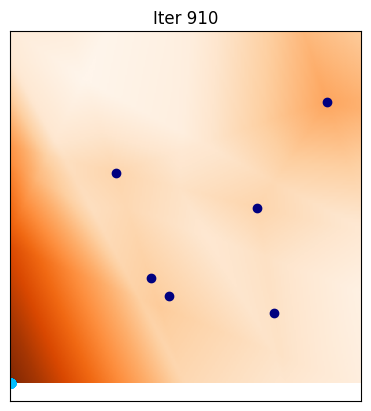

[915/1000], -50.124317


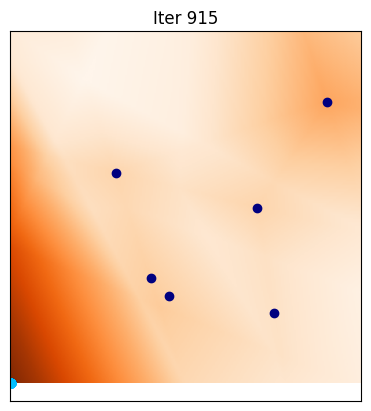

[920/1000], -50.124237


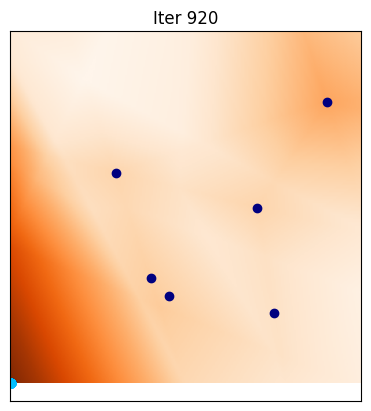

[925/1000], -50.124306


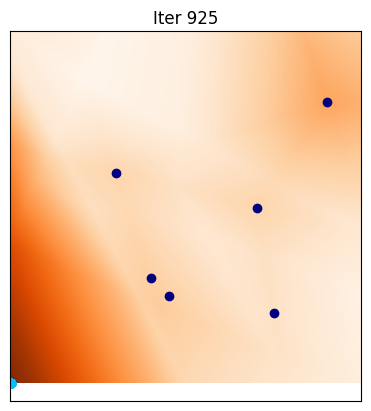

[930/1000], -50.124290


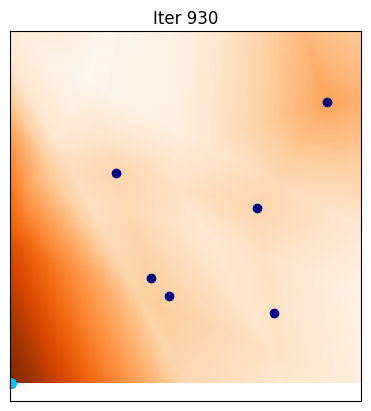

[935/1000], -50.124279


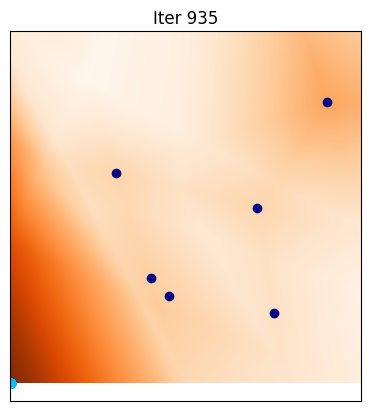

[940/1000], -50.124191


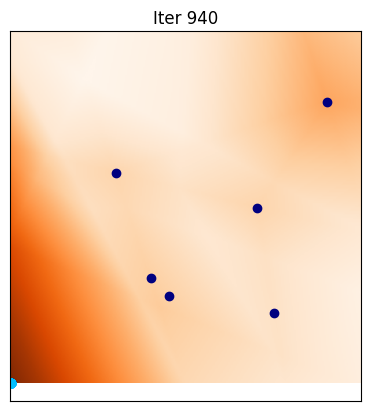

[945/1000], -50.124180


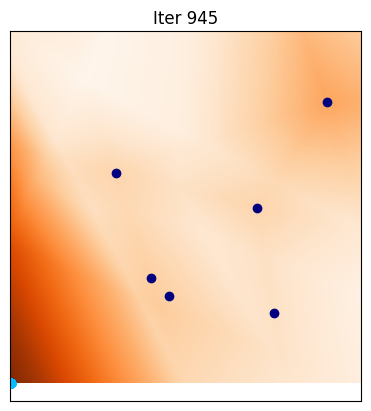

[950/1000], -50.124283


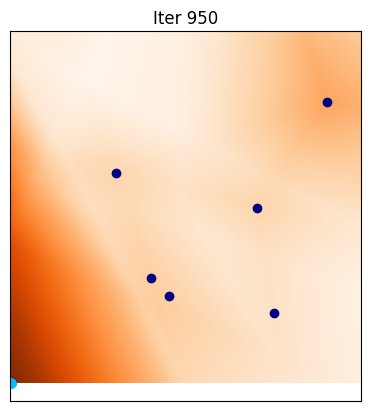

[955/1000], -50.124405


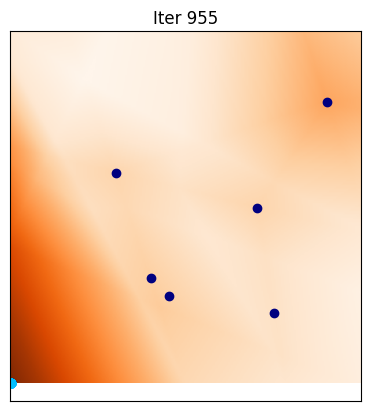

[960/1000], -50.124317


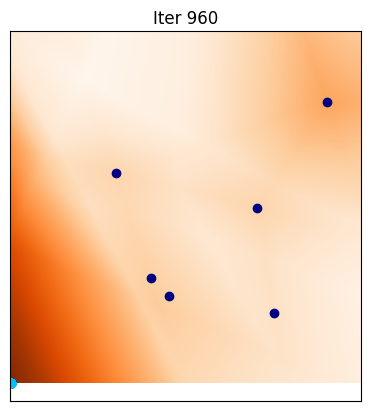

[965/1000], -50.124256


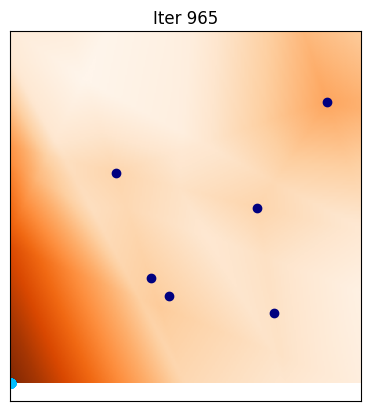

[970/1000], -50.124298


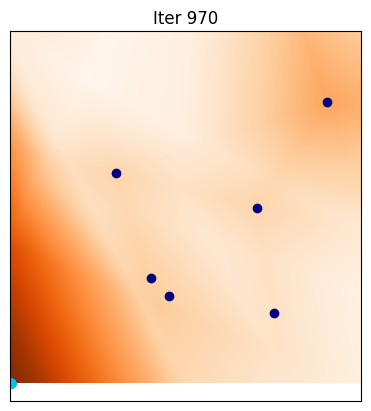

[975/1000], -50.124393


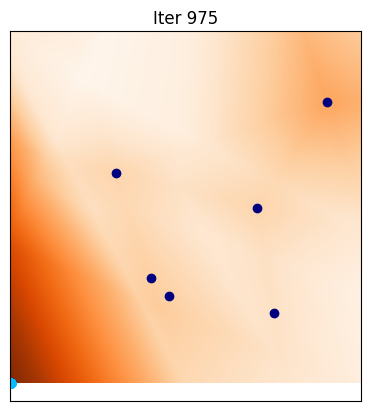

[980/1000], -50.124302


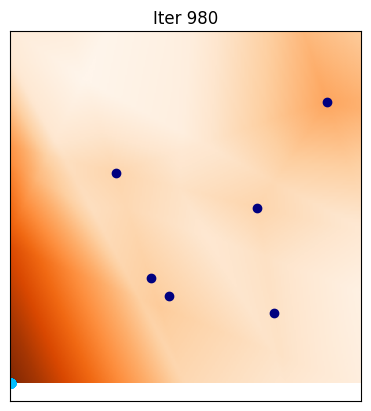

[985/1000], -50.124218


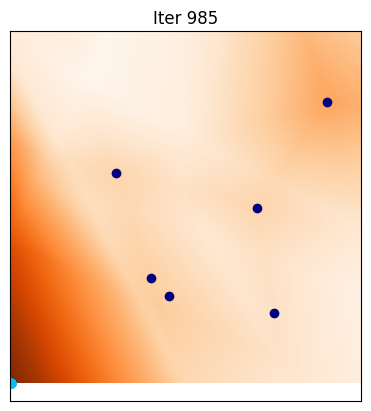

[990/1000], -50.124393


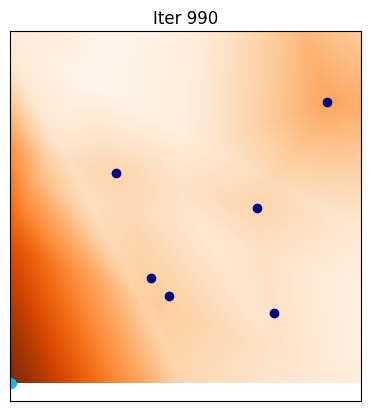

[995/1000], -50.124317


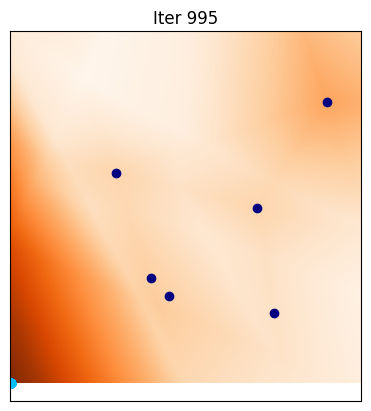

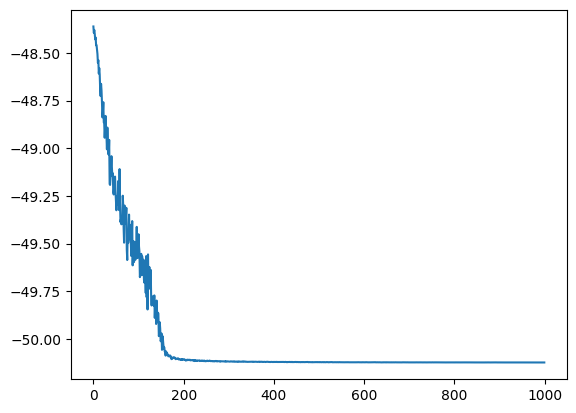

In [12]:
### ... ###
# Fix the discriminator
for p in D.parameters():
    p.requires_grad = False

# Parameters for generator optimization
lr = 0.002
niterG = 1000

optimG = optim.Adam(G.parameters(), lr=lr)

Glosses = []

for iter in range(0, niterG):
    ### UPDATE OF G ###
    optimG.zero_grad()
    z = torch.randn(b, n_in, device=device)
    x = G(z)
    Gloss = -torch.mean(D(x))  # WGAN loss for generator
    Gloss.backward()
    optimG.step()
    ### SAVE LOSS ###
    Glosst = Gloss.item()
    Glosses.append(Glosst)

    if (iter % iter_display == 0):
        print('[%d/%d], %f' % (iter, niterG, Glosst))
        Dxgrid = D(xgrid).detach().cpu().numpy().reshape(nr, nc)
        x = G(z)
        xd = x.detach().squeeze(1)
        strtitle = 'Iter ' + str(iter)
        fig = plt.figure(dpi=100)
        plt.xticks([])
        plt.yticks([])
        plt.imshow(Dxgrid, cmap='Oranges', extent=extent)  # discriminator
        plt.scatter(xd[:, 0].cpu(), xd[:, 1].cpu(), c='deepskyblue', alpha=0.5)
        plt.scatter(y[:, 0].cpu(), y[:, 1].cpu(), c='navy')
        plt.title(strtitle)
        plt.show()

plt.plot(Glosses)

<br/><br/><br/><br/>

# BONUS Exercise (to do at home) : Learn a standard GAN

## Define Loss for GAN training

For stable GAN training uses the Binary cross-entropy loss which takes labeled data as input.

The data points $y$ should correspond to values $\approx 1$, whereas fake points $x$ should get values $\approx 0$.

We also introduce the sigmoid function. for displaying purpose: for GAN training, the discriminator values in $[0,1]$ will be obtained by applying after $D$.

In [13]:
criterion = nn.BCEWithLogitsLoss()
V1 = torch.full((n,1), 1. , dtype=torch.float, device=device)
V0 = torch.full((b,1), 0. , dtype=torch.float, device=device)

sig = nn.Sigmoid()

## Train the discriminator for a fixed generator

QUESTION: Complete the following code at the blocks ###...###

[0/1000], 1.383946


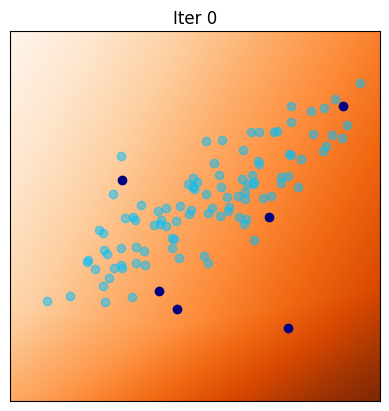

[100/1000], 1.140935


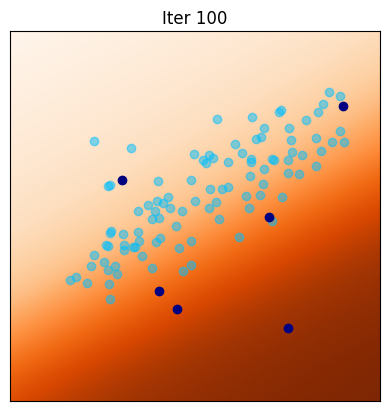

[200/1000], 1.053919


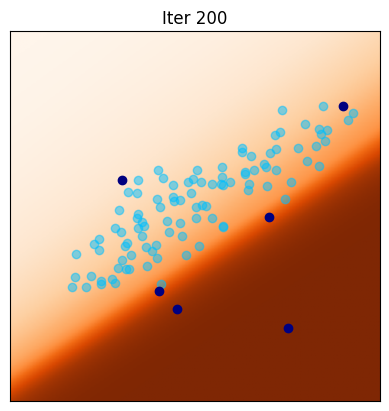

[300/1000], 1.128344


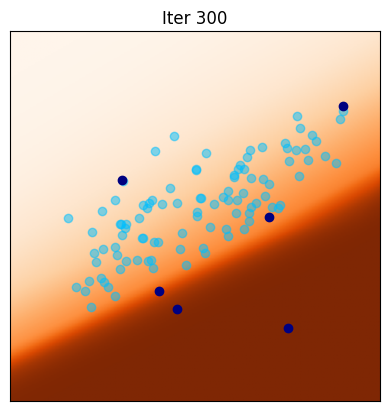

[400/1000], 1.250186


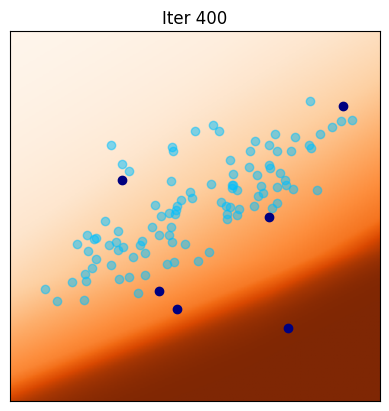

[500/1000], 1.176988


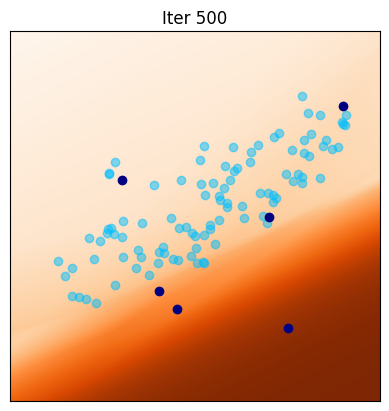

[600/1000], 1.091263


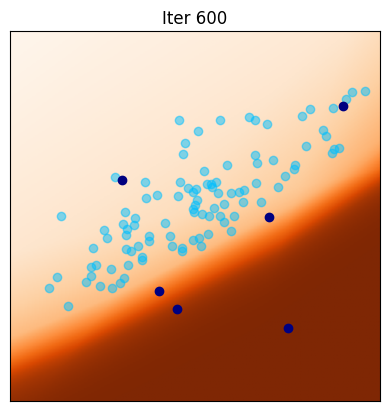

[700/1000], 0.941557


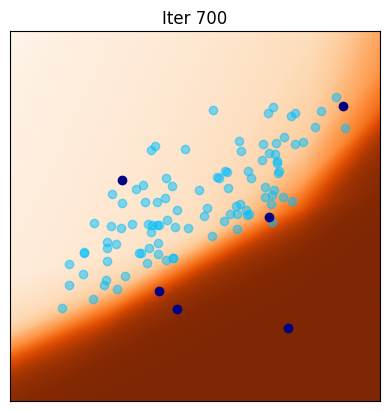

[800/1000], 0.929800


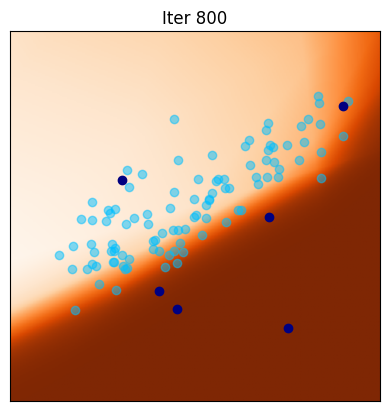

[900/1000], 0.813539


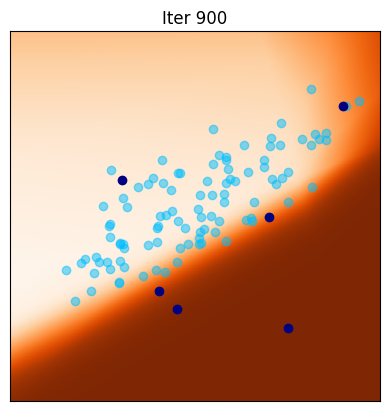

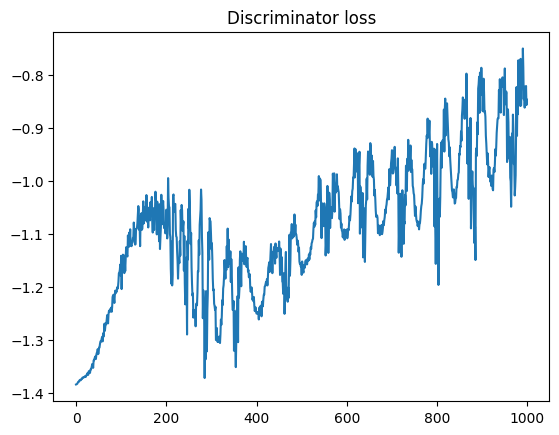

In [14]:
torch.manual_seed(1)  # initialize random seed for reproducibility

# parameters for discriminator optimization
lrdisc = 0.002
beta_1 = 0.5
beta_2 = 0.999
niterD=1000

# Initialize generators and discriminators
G = Generator(n_in=n_in, n_out=d, n_hid=10, nlayers=3, device=device)
optimG = optim.Adam(G.parameters(), lr=lr)

D = Discriminator(n_in=d, n_hid=10).to(device)
optimD = optim.Adam(D.parameters(), lr=lrdisc, betas=(beta_1, 0.999))

iter_display = 100  # display current configuration each iter_display iteration

Dlosses = []

for iter in range(0,niterD):

    ### UPDATE OF D ###
    ### ... ###
    z = torch.randn(b, n_in, device=device)
    x = G(z).detach()  # Detach to avoid training G

    # Calculate discriminator loss
    Dloss_real = criterion(D(y), V1)
    Dloss_fake = criterion(D(x), V0)
    Dloss = Dloss_real + Dloss_fake

    # Update discriminator
    Dloss.backward()
    optimD.step()

    ### SAVE LOSS ###
    Dlosst = Dloss.item()
    Dlosses.append(-Dlosst)

    if(iter%iter_display == 0):
        print('[%d/%d], %f' % (iter, niterD, Dlosst))
        Dxgrid = sig(D(xgrid)).detach().cpu().numpy().reshape(nr,nc)
        x = G(z)
        xd = x.detach().squeeze(1)
        strtitle = 'Iter '+str(iter)
        fig = plt.figure(dpi=100)
        plt.xticks([])
        plt.yticks([])
        plt.imshow(Dxgrid,cmap = 'Oranges', extent=extent)  # discriminator
        plt.scatter(xd[:, 0].cpu(), xd[:,1].cpu(),c='deepskyblue',alpha=.5)
        plt.scatter(y[:, 0].cpu(), y[:,1].cpu(),c='navy')
        plt.title(strtitle)
        plt.show()


### Plot the evolution of the discriminator loss ###
plt.figure(dpi=100)
plt.plot(Dlosses)
plt.title('Discriminator loss')
plt.show()

## Train both the Generator and Discriminator

[0/100] 	Loss_D: 1.2335	Loss_G: 0.8061


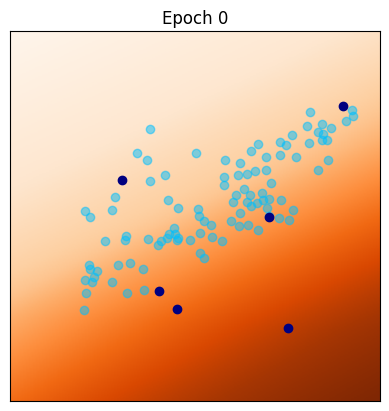

[1/100] 	Loss_D: 1.0810	Loss_G: 0.9202
[2/100] 	Loss_D: 1.0182	Loss_G: 1.0080
[3/100] 	Loss_D: 0.9553	Loss_G: 1.1172
[4/100] 	Loss_D: 0.9102	Loss_G: 1.2342
[5/100] 	Loss_D: 0.8547	Loss_G: 1.4608
[6/100] 	Loss_D: 0.7619	Loss_G: 1.4250
[7/100] 	Loss_D: 0.7863	Loss_G: 1.7120
[8/100] 	Loss_D: 0.8451	Loss_G: 1.6432
[9/100] 	Loss_D: 0.8324	Loss_G: 1.6112
[10/100] 	Loss_D: 0.8401	Loss_G: 1.3920


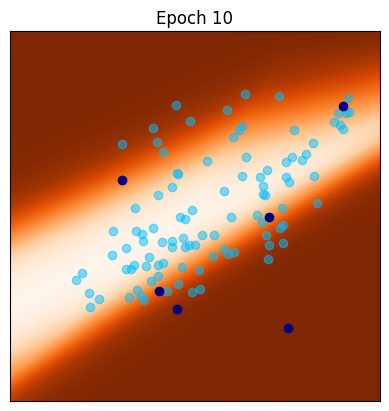

[11/100] 	Loss_D: 0.9652	Loss_G: 1.6411
[12/100] 	Loss_D: 1.0028	Loss_G: 1.3802
[13/100] 	Loss_D: 1.0215	Loss_G: 1.4168
[14/100] 	Loss_D: 1.0989	Loss_G: 1.2867
[15/100] 	Loss_D: 1.1671	Loss_G: 1.1954
[16/100] 	Loss_D: 1.0965	Loss_G: 1.0414
[17/100] 	Loss_D: 1.0839	Loss_G: 1.0865
[18/100] 	Loss_D: 1.1614	Loss_G: 1.1402
[19/100] 	Loss_D: 1.0528	Loss_G: 1.0790
[20/100] 	Loss_D: 1.0552	Loss_G: 0.9908


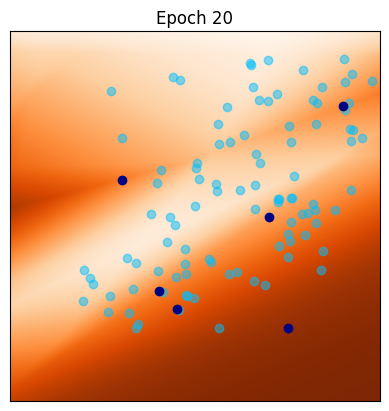

[21/100] 	Loss_D: 1.0435	Loss_G: 1.0995
[22/100] 	Loss_D: 1.0294	Loss_G: 1.0926
[23/100] 	Loss_D: 1.0857	Loss_G: 1.1498
[24/100] 	Loss_D: 1.0334	Loss_G: 1.2132
[25/100] 	Loss_D: 0.9864	Loss_G: 0.9943
[26/100] 	Loss_D: 1.0092	Loss_G: 1.2984
[27/100] 	Loss_D: 0.9142	Loss_G: 1.2385
[28/100] 	Loss_D: 1.0247	Loss_G: 1.3390
[29/100] 	Loss_D: 0.9932	Loss_G: 1.3539
[30/100] 	Loss_D: 1.0015	Loss_G: 1.5026


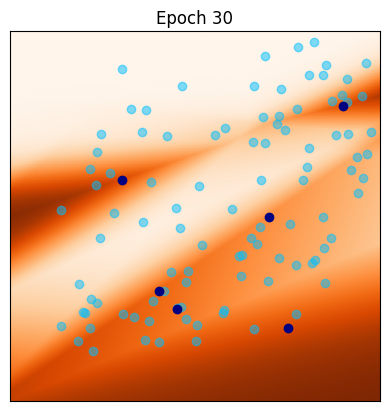

[31/100] 	Loss_D: 0.9417	Loss_G: 1.2240
[32/100] 	Loss_D: 0.9664	Loss_G: 1.8634
[33/100] 	Loss_D: 0.9260	Loss_G: 1.5736
[34/100] 	Loss_D: 0.8700	Loss_G: 1.2802
[35/100] 	Loss_D: 0.9013	Loss_G: 1.6489
[36/100] 	Loss_D: 0.8452	Loss_G: 1.4906
[37/100] 	Loss_D: 0.9523	Loss_G: 1.6416
[38/100] 	Loss_D: 0.8872	Loss_G: 1.4627
[39/100] 	Loss_D: 0.8069	Loss_G: 1.6032
[40/100] 	Loss_D: 0.8658	Loss_G: 1.8832


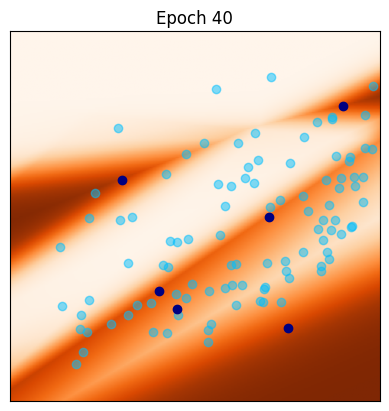

[41/100] 	Loss_D: 0.8760	Loss_G: 1.5544
[42/100] 	Loss_D: 0.8926	Loss_G: 1.5520
[43/100] 	Loss_D: 0.7453	Loss_G: 1.4655
[44/100] 	Loss_D: 0.7969	Loss_G: 1.6022
[45/100] 	Loss_D: 0.8703	Loss_G: 1.6846
[46/100] 	Loss_D: 0.8645	Loss_G: 1.9024
[47/100] 	Loss_D: 0.7855	Loss_G: 1.6318
[48/100] 	Loss_D: 0.8089	Loss_G: 1.8455
[49/100] 	Loss_D: 0.8687	Loss_G: 1.9619
[50/100] 	Loss_D: 0.8622	Loss_G: 1.7259


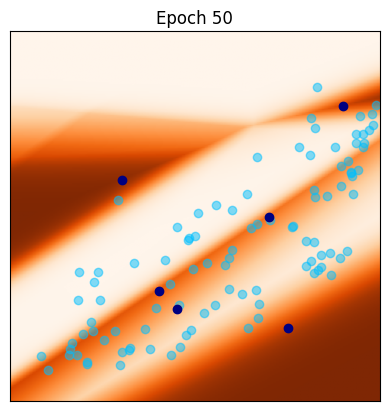

[51/100] 	Loss_D: 0.8260	Loss_G: 1.4758
[52/100] 	Loss_D: 0.7694	Loss_G: 1.2897
[53/100] 	Loss_D: 0.8633	Loss_G: 1.7079
[54/100] 	Loss_D: 0.9358	Loss_G: 1.9107
[55/100] 	Loss_D: 0.8493	Loss_G: 1.6283
[56/100] 	Loss_D: 0.8219	Loss_G: 1.5757
[57/100] 	Loss_D: 0.7703	Loss_G: 1.7549
[58/100] 	Loss_D: 0.7910	Loss_G: 1.4788
[59/100] 	Loss_D: 0.8414	Loss_G: 1.5893
[60/100] 	Loss_D: 0.7698	Loss_G: 1.4449


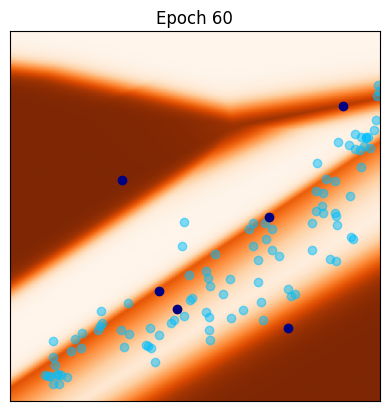

[61/100] 	Loss_D: 0.8877	Loss_G: 1.9233
[62/100] 	Loss_D: 0.7423	Loss_G: 1.4020
[63/100] 	Loss_D: 0.8229	Loss_G: 1.6102
[64/100] 	Loss_D: 0.8168	Loss_G: 1.5150
[65/100] 	Loss_D: 0.7934	Loss_G: 1.8862
[66/100] 	Loss_D: 0.7815	Loss_G: 1.4970
[67/100] 	Loss_D: 0.8125	Loss_G: 1.7335
[68/100] 	Loss_D: 0.8009	Loss_G: 1.7954
[69/100] 	Loss_D: 0.8030	Loss_G: 1.6578
[70/100] 	Loss_D: 0.8498	Loss_G: 1.7930


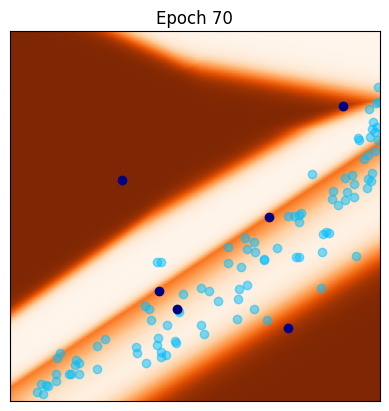

[71/100] 	Loss_D: 0.8098	Loss_G: 1.7024
[72/100] 	Loss_D: 0.7974	Loss_G: 1.5829
[73/100] 	Loss_D: 0.8090	Loss_G: 1.6809
[74/100] 	Loss_D: 0.7740	Loss_G: 1.6114
[75/100] 	Loss_D: 0.7641	Loss_G: 1.5516
[76/100] 	Loss_D: 0.8505	Loss_G: 1.6159
[77/100] 	Loss_D: 0.8052	Loss_G: 1.5086
[78/100] 	Loss_D: 0.7950	Loss_G: 1.5736
[79/100] 	Loss_D: 0.8303	Loss_G: 1.5760
[80/100] 	Loss_D: 0.7934	Loss_G: 1.6099


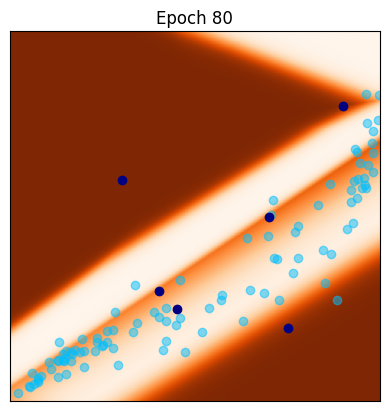

[81/100] 	Loss_D: 0.8060	Loss_G: 1.7046
[82/100] 	Loss_D: 0.7839	Loss_G: 1.1567
[83/100] 	Loss_D: 0.8110	Loss_G: 1.4987
[84/100] 	Loss_D: 0.8515	Loss_G: 1.5202
[85/100] 	Loss_D: 0.8049	Loss_G: 1.3086
[86/100] 	Loss_D: 0.8325	Loss_G: 1.8174
[87/100] 	Loss_D: 0.8339	Loss_G: 1.7931
[88/100] 	Loss_D: 0.8249	Loss_G: 1.3325
[89/100] 	Loss_D: 0.8280	Loss_G: 1.2385
[90/100] 	Loss_D: 0.8384	Loss_G: 1.6937


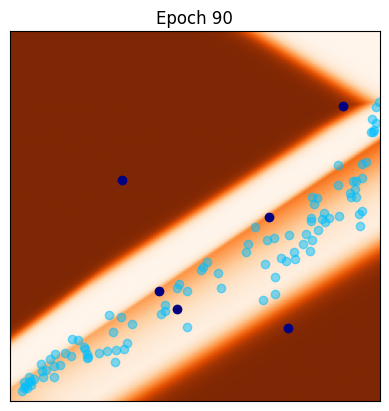

[91/100] 	Loss_D: 0.8382	Loss_G: 1.4804
[92/100] 	Loss_D: 0.8346	Loss_G: 1.2642
[93/100] 	Loss_D: 0.8133	Loss_G: 1.2611
[94/100] 	Loss_D: 0.8676	Loss_G: 1.6642
[95/100] 	Loss_D: 0.8185	Loss_G: 1.3561
[96/100] 	Loss_D: 0.8675	Loss_G: 1.4251
[97/100] 	Loss_D: 0.8083	Loss_G: 1.4620
[98/100] 	Loss_D: 0.7916	Loss_G: 1.4175
[99/100] 	Loss_D: 0.8563	Loss_G: 1.4924


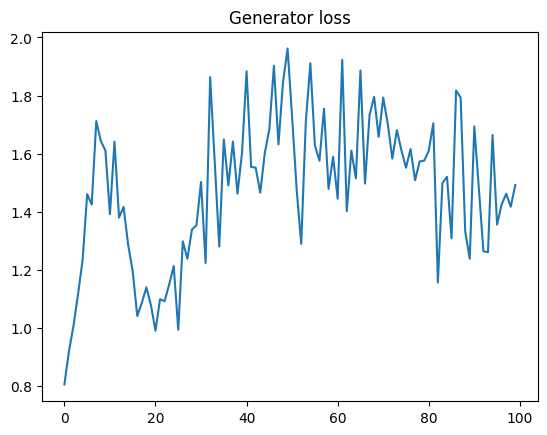

In [17]:
lr = 0.002   # learning rate for generator
lrdisc = 0.002   # learning rate for generator

## parameters for training
n_epochs = 100
niterD=100
niterG=1

torch.manual_seed(1)  # initialize random seed for reproducibility

# Initialize generators and discriminators
G = Generator(n_in=n_in, n_out=d, n_hid=10, nlayers=3, device=device)
optimG = optim.Adam(G.parameters(), lr=lr)

D = Discriminator(n_in=d, n_hid=10).to(device)
optimD = optim.Adam(D.parameters(), lr=lrdisc, betas=(beta_1, beta_2))

Glosses = []
Dlosses = []

iter_display = 10

# Main loop
for epoch in range(n_epochs):

    ############################
    ### Train discriminator (niterD iterations)
    ############################
    for iter in range(0,niterD):
        ### ... ###
        optimD.zero_grad()
        z = torch.randn(b, n_in, device=device)
        x = G(z)
        Dloss_real = criterion(D(y), V1)
        Dloss_fake = criterion(D(x), V0)
        Dloss = Dloss_real + Dloss_fake
        Dloss.backward()

        optimD.step()
    ############################
    ### Train generator (niterG iterations)
    ############################
    for iter in range(0,niterG):
        ### ... ###
        optimG.zero_grad()
        z = torch.randn(b, n_in, device=device)
        x = G(z)
        # Create a target tensor of ones with the same size as the discriminator output
        Gloss = criterion(D(x), torch.ones_like(D(x)))
        Gloss.backward()
        optimG.step()

    # Output training stats
    print('[%d/%d] \tLoss_D: %.4f\tLoss_G: %.4f'
      % (epoch, n_epochs, Dloss.item(), Gloss.item()))
    Glosses.append(Gloss.item())
    Dlosses.append(-Dloss.item())


    if(epoch % iter_display == 0):
        Dxgrid = sig(D(xgrid)).detach().cpu().numpy().reshape(nr,nc)
        z = torch.randn(b, n_in, device=device) #Corrected this line
        x = G(z)
        xd = x.detach().squeeze(1)
        strtitle = 'Epoch '+str(epoch)
        fig = plt.figure(dpi=100)
        plt.xticks([])
        plt.yticks([])
        plt.imshow(Dxgrid,cmap = 'Oranges', extent=extent)  # discriminator
        plt.scatter(xd[:, 0].cpu(), xd[:,1].cpu(),c='deepskyblue',alpha=.5)
        plt.scatter(y[:, 0].cpu(), y[:,1].cpu(),c='navy')
        plt.title(strtitle)
        plt.show()

# Save final generator for later use
gan = Generator(n_in=n_in, n_out=d, n_hid=10, nlayers=3, device=device)
gan.load_state_dict(G.state_dict())

### Plot the evolution of the discriminator loss ###
plt.figure(dpi=100)
plt.plot(Glosses)
plt.title('Generator loss')
plt.show()